In [ ]:
import rioxarray
import xarray as xr
import geopandas as gpd
import pandas as pd
import sys
sys.path.append('/home/KOL/p6065/python-scripts/core/')

from gridParams import *

from modelParams import *

from mpl_toolkits.basemap import Basemap
import matplotlib.pyplot as plt
import matplotlib
from matplotlib.colors import from_levels_and_colors
from matplotlib import colors

from shapely.geometry import box, mapping

lond02, latd02 = d02.getCoordsGrids(lonlat=True,center=False)
mapb=Basemap(**d03.basemap_proj)
plt.rcParams['figure.figsize'] = 20,8
plt.rcParams.update({'font.size': 18})
font = matplotlib.font_manager.FontProperties( style='italic', size=16)

# biogenne emisie CAMS a MEGAN (pocitany Jurom) pre 2017


## CAMS MAPY
CAMS pocital globalne biogenne emisie pre viacero rokov [odkaz](https://atmosphere.copernicus.eu/sites/default/files/2018-05/CAMS81_2017SC1_D81.3.1.1-201802_v2_APPROVED_Ver2.pdf) a [odkaz2](https://eccad.aeris-data.fr/2020/04/09/global-biogenic-dataet-updated/). My sme vystrihli oblast pre Slovensko.
Vysledky su v $kg/m^2 s$. 

In [2]:
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

sk=gpd.read_file('/home/KOL/p6001/Downloads/ah_shp_0/sr_0.shx',encoding='utf-8')
sk = sk.to_crs({'init': 'epsg:4326'})

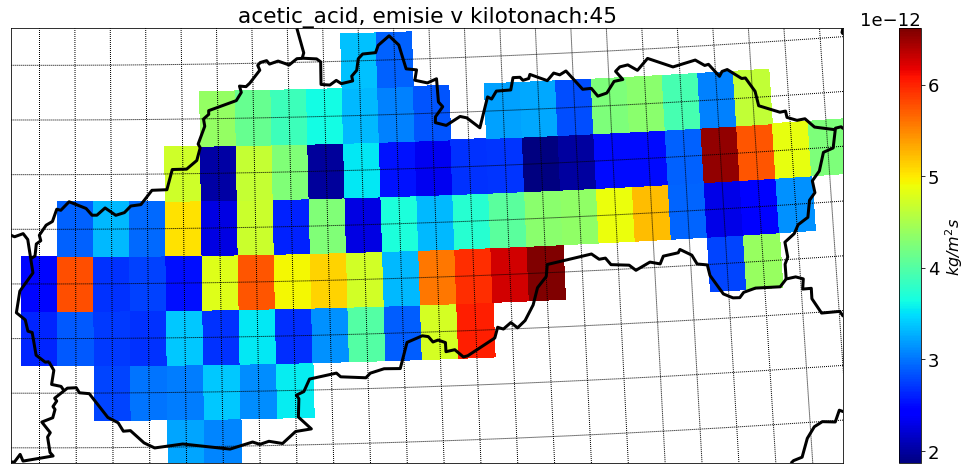

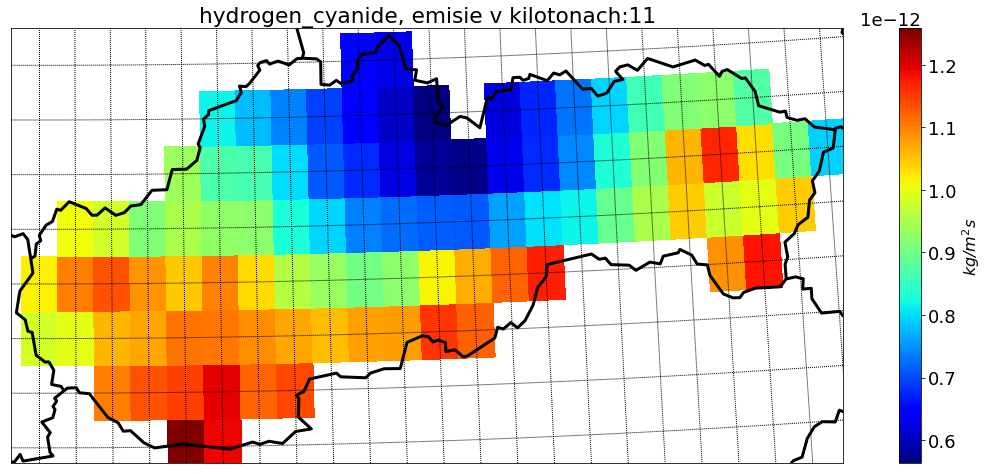

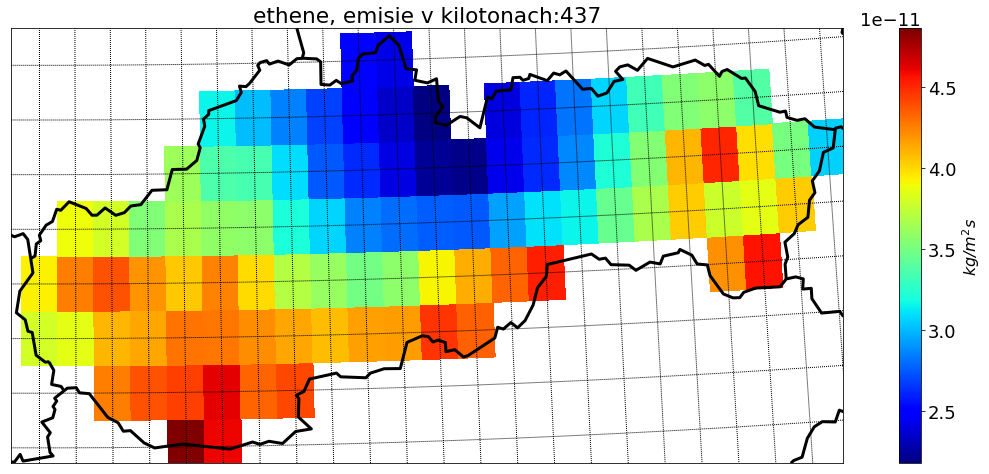

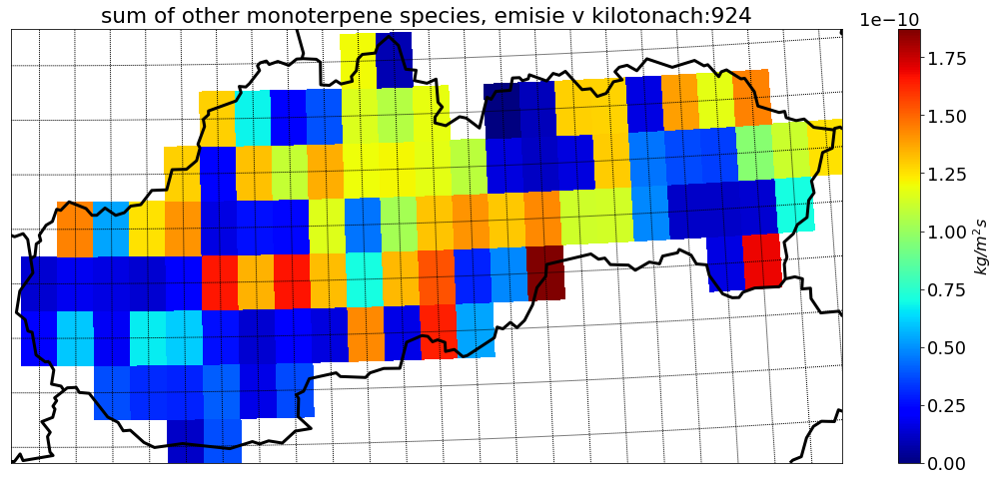

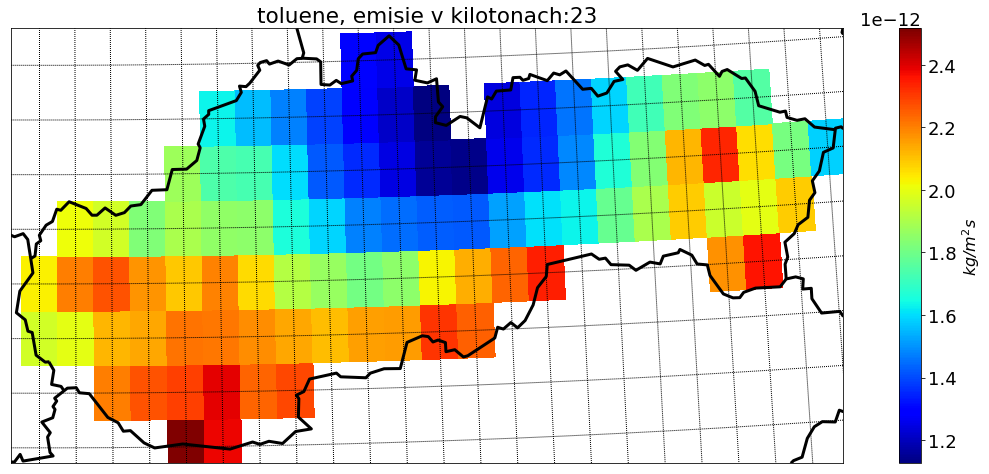

...

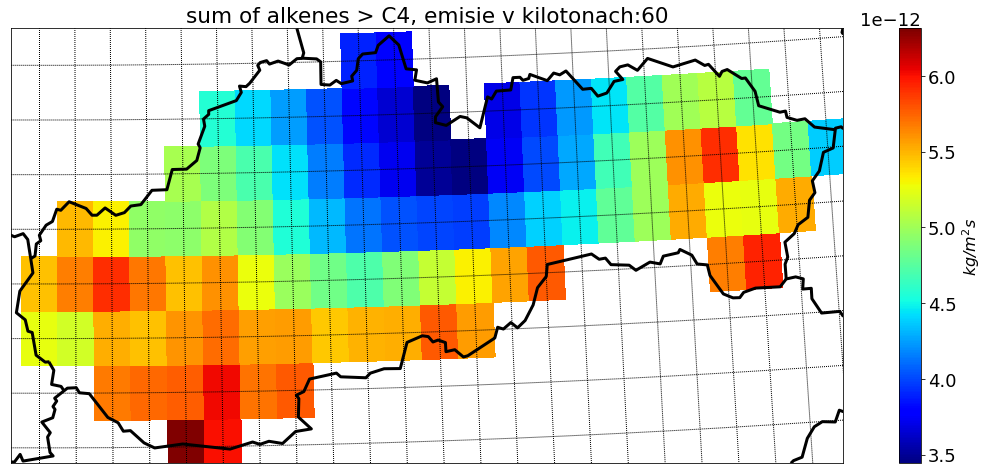

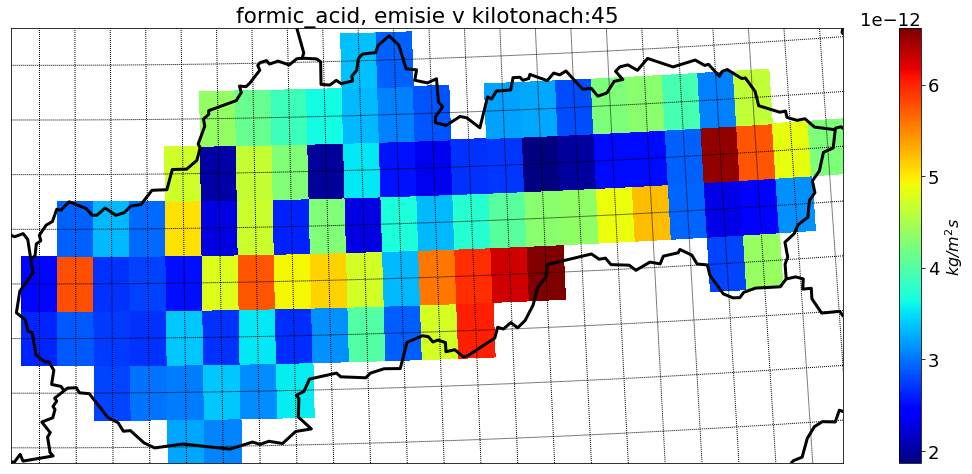

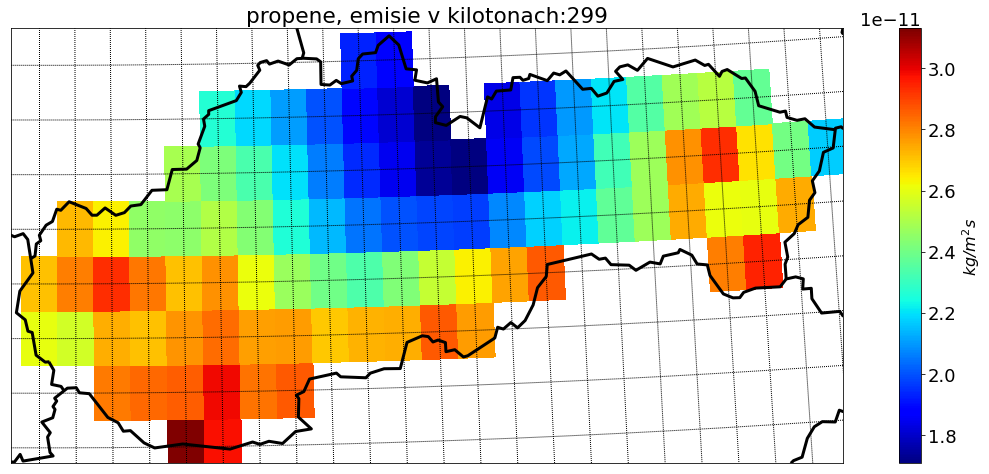

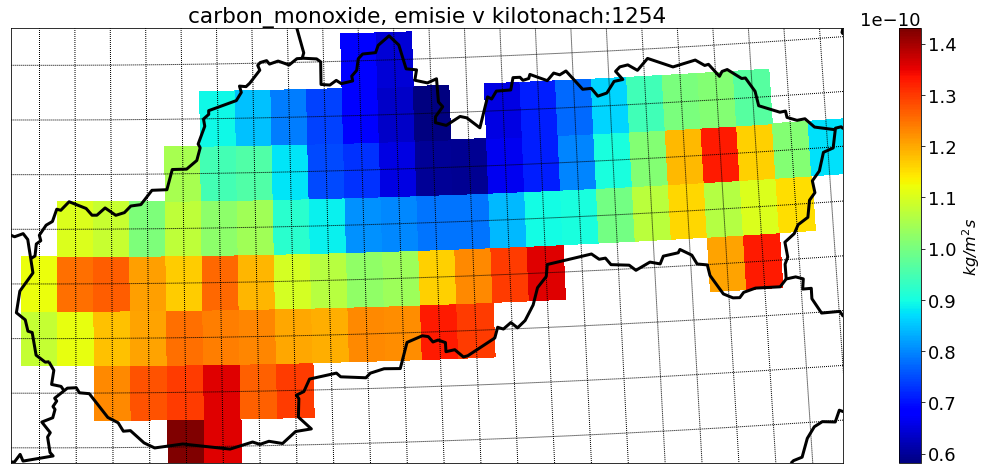

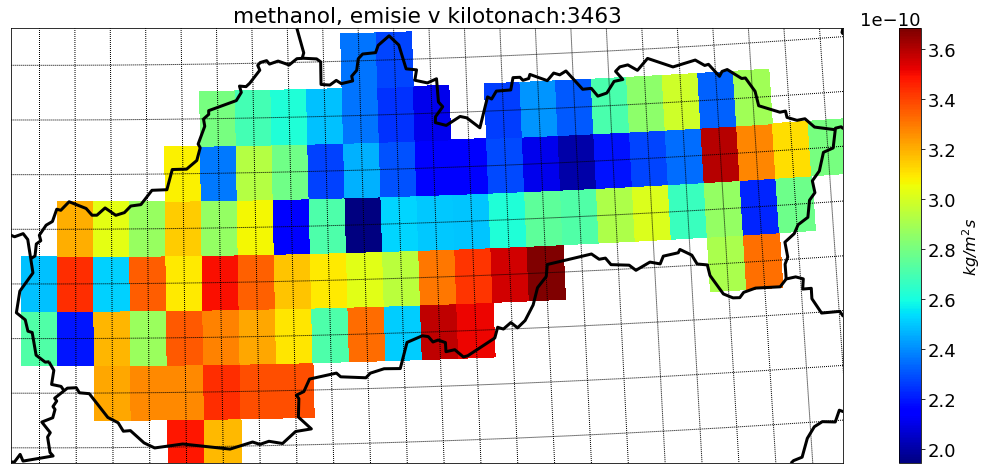

In [3]:
meridians = np.arange(16.75,22.6,0.25)
pararels = np.arange(47.75,49.75,0.25)


# aby bolo lon, lat ako mriezka
def lon_lat_mriezka(xarray_objekt):
    
    lon2D=np.zeros((xarray_objekt.lat.data.shape[0],xarray_objekt.lon.data.shape[0]))
    lat2D=np.zeros(lon2D.shape)
     
    for i in range(0,lon2D.shape[1]): lon2D[:,i]= np.array(xarray_objekt.lon.data[i])
    for i in range(0,lon2D.shape[0]): lat2D[i,:]= np.array(xarray_objekt.lat.data[i])    
    
    return (lon2D, lat2D);

#!!!!!!!!!!Basemap nezobrazuje horny riadok a pravy stlpec, doplnenie pre clipped 2 aby to robila

def doplnenie_lon_lat(pole_lon, pole_lat, dopl_lon, dopl_lat):
    
    pole_lonp1 = np.zeros((pole_lon.shape[0]+1,pole_lon.shape[1]+1))
    pole_lonp1[:-1,:-1] = pole_lon    
    pole_latp1 = np.zeros((pole_lon.shape[0]+1,pole_lon.shape[1]+1))
    pole_latp1[:-1,:-1] = pole_lat    
    pole_latp1[-1,:]=dopl_lat
    pole_latp1[:,-1]=pole_latp1[:,0]
    pole_lonp1[:,-1]=dopl_lon
    pole_lonp1[-1,:]=pole_lonp1[0,:]
    
    return (pole_lonp1,pole_latp1);

def doplnenie_nula_pole(pole):
    
    datap1 = np.zeros((pole.shape[0]+1,pole.shape[1]+1))
    datap1[:-1,:-1] = pole
    
    return datap1;



CAMS_emisie_v_tonach={}
for i in os.listdir('/data/oko/dusan/CAMS_BIOG'):
    a=xr.open_dataset('/data/oko/dusan/CAMS_BIOG/'+i,decode_times=False)
    a=a.rio.set_spatial_dims("lon","lat",inplace=True)
    a=a.rio.write_crs("epsg:4326")
    clipped = a.rio.clip(sk.geometry.apply(mapping), a.rio.crs)
    
    # clippped prvy sposob
    lonCAMS_cl, latCAMS_cl = lon_lat_mriezka(clipped)
    lonCAMS_cl, latCAMS_cl = doplnenie_lon_lat(lonCAMS_cl, latCAMS_cl, lonCAMS_cl.max()+0.25,latCAMS_cl.max()+0.25)
    pole_cl=doplnenie_nula_pole(np.sum(clipped.emiss_bio_monthly.data[:12], axis=0))
    
    nazov=a.emiss_bio_monthly.long_name.strip()
                              
    emisie=np.nansum(pole_cl)*49034066178*24*365*60*60/(1000*12)
    
    CAMS_emisie_v_tonach[nazov]=emisie
    
    mapb.drawcountries(linewidth=3)
    mapb.drawmeridians(meridians)
    mapb.drawparallels(pararels)                         # np.sum(clipped2.emiss_bio_monthly.data, axis=0)   
    
    b=mapb.pcolormesh(lonCAMS_cl-0.25/2,latCAMS_cl-0.25/2,pole_cl,latlon=True,cmap=plt.cm.jet)# vmin=0,vmax=50)

    cb=plt.colorbar(b,label='kg/m$^2$s')
    #cb.set_ticks()

    cb.ax.yaxis.label.set_font_properties(font)
    plt.title(f'{nazov}, emisie v kilotonach:{emisie/1000:.0f}')

    #plt.savefig('/data/oko/ochrana_ovzdusia_2019/hustota_obrazok', dpi=300, bbox_inches='tight')
    plt.show()
    plt.close() 

## CAMS graf totalnych emisii.
Kedze su vysledky su v $𝑘𝑔/𝑚^2𝑠$ na prepocitanie v tonach treba pouzit faktor:
49 034 066 178$\times$24$\times$365$\times$60$\times$60/(1000$\times$12), kde prve je pocet stvorcovych metrov SR, potom nasleduje pocet sekund v roku predelene 1000 (kg na tony) a 12 pocet mesiacov (to sme tu uz zaratali scitanim mesacnych suborov)


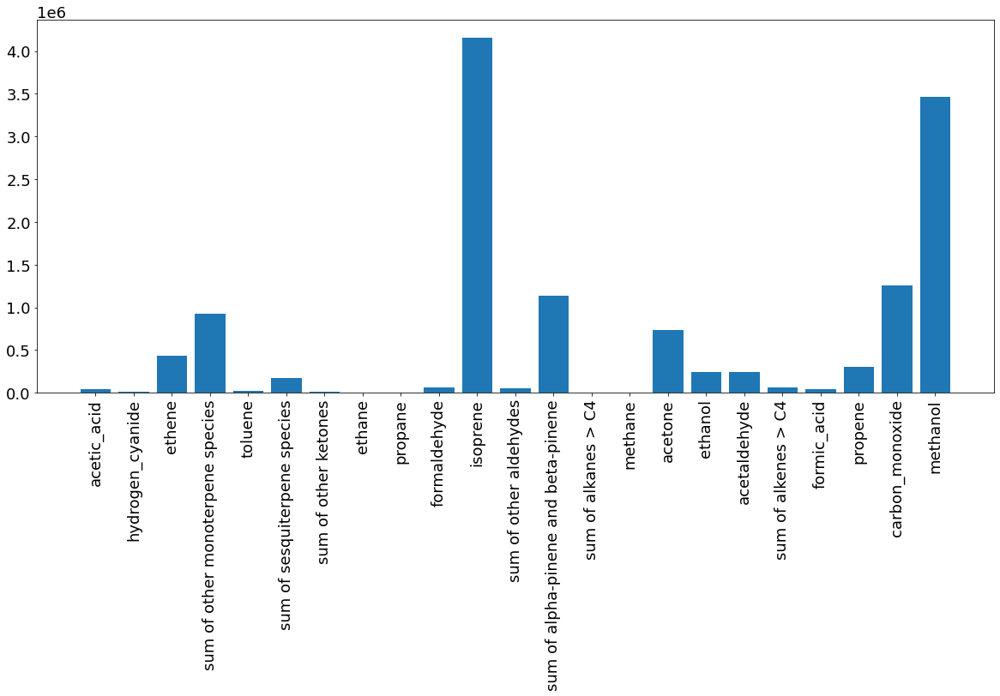

In [5]:
plt.bar(CAMS_emisie_v_tonach.keys(), CAMS_emisie_v_tonach.values() )
plt.xticks( rotation='vertical')
plt.show()
plt.close()

## Megan mapy

Juro spravil vypocet modelom MEGAN [odkaz na clanok o Megan](https://gmd.copernicus.org/articles/10/903/2017/gmd-10-903-2017.pdf), vysledky su hodinove data v $mol/s$, aby sme ich mali v tonach, treba ich vynasobit faktorom 3600$\times$M/1000 000, kde 3600 je pocet sekund za hodinu, M je molova hmotnost v g/mol a faktor 1000 000 je za prevod z gramov na tony.

Latky v Megan, Juro skontroluj ci som to dobre priradil, hlavne tie s otaznikmi som dal len tak najblizsie k CMAQ modelu'

In [6]:
meg=xr.open_dataset('/data/oko/dusan/emisie/megan_bio.nc')

In [11]:
konvt=pd.read_csv('/data/oko/dusan/emisie/tabulka_molovych_hmotnosti',sep='|')
dic_konv=dict(zip(list(map(lambda x: x.strip(),list(konvt[' **Model Species** '])[1:])),list(map(lambda x: float(x.strip()),list(konvt[' **Molecular Weight** '])[1:]))))
dic_def=dict(zip(list(map(lambda x: x.strip(),list(konvt[' **Model Species** '])[1:])),list(map(lambda x: x.strip(),list(konvt[' **Definition**                                                                     '])[1:]))))


dic_konv['CH4']= 16
dic_def['CH4']= 'methane'

dic_konv['NR']= 119.1
dic_def['NR']= 'organic nitrate ???'

dic_konv['XYL']= 106.2
dic_def['XYL']= 'xylene ???'

dic_meg_ton={}
for i in meg.data_vars: 
    if i in dic_konv:
       dic_meg_ton[f"{i}:{dic_def[i]}"]= np.nansum(meg[i].data)*dic_konv[i]*3600/1000000
       print(f"{i} ({dic_def[i]}), mol. hmot.: {dic_konv[i]}, emisie: {dic_meg_ton[f'{i}:{dic_def[i]}']:.0f} ton")
    elif i not in ['GDAY','NH3']:
       print('!!!!!',i)


ISOP (isoprene), mol. hmot.: 68.1, emisie: 216367 ton
TERP (monoterpenes), mol. hmot.: 136.2, emisie: 49378 ton
PAR (carbon-carbon single bond), mol. hmot.: 72.1, emisie: 72863 ton
XYL (xylene ???), mol. hmot.: 106.2, emisie: 617 ton
OLE (terminal alkene bond), mol. hmot.: 42.1, emisie: 6651 ton
NR (organic nitrate ???), mol. hmot.: 119.1, emisie: 66902 ton
MEOH (methanol), mol. hmot.: 32.0, emisie: 80062 ton
CH4 (methane), mol. hmot.: 16, emisie: 48 ton
NO (nitric oxide), mol. hmot.: 30.0, emisie: 1871 ton
ALD2 (acetaldehyde), mol. hmot.: 44.0, emisie: 8750 ton
ETOH (ethanol), mol. hmot.: 46.1, emisie: 8766 ton
FORM (formaldehyde), mol. hmot.: 30.0, emisie: 2218 ton
ALDX (aldehydes with 3 or more carbons), mol. hmot.: 58.1, emisie: 2610 ton
TOL (toluene and other monoalkyl aromatics), mol. hmot.: 92.1, emisie: 1242 ton
IOLE (internal alkene bond), mol. hmot.: 56.1, emisie: 3530 ton
CO (carbon monoxide), mol. hmot.: 28.0, emisie: 50680 ton
ETHA (ethane), mol. hmot.: 30.1, emisie: 96 to

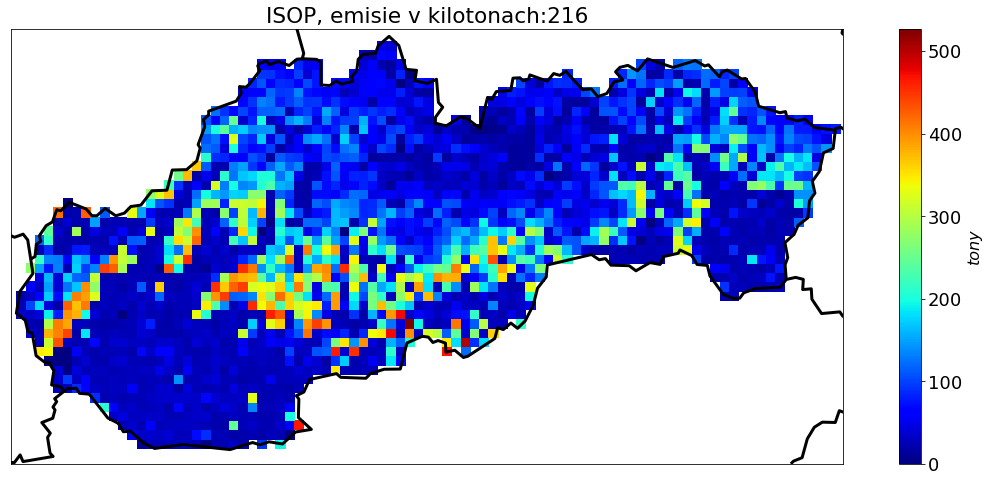

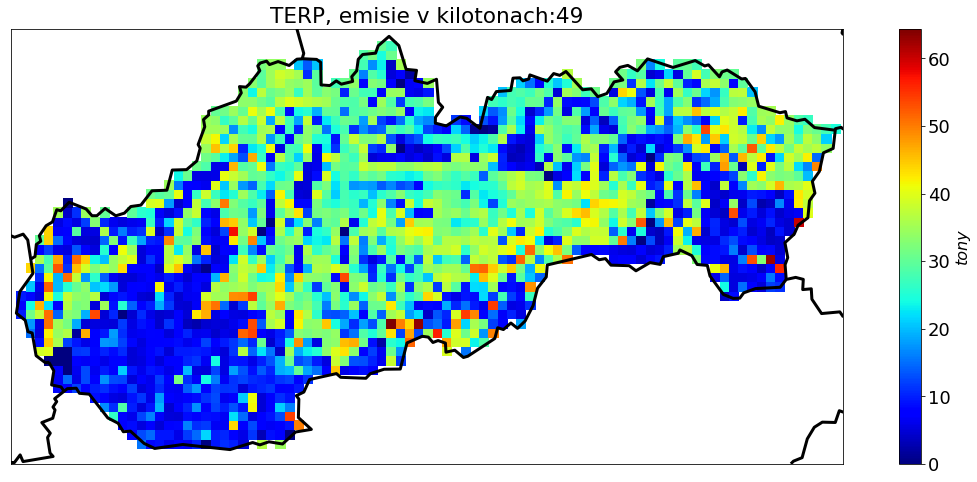

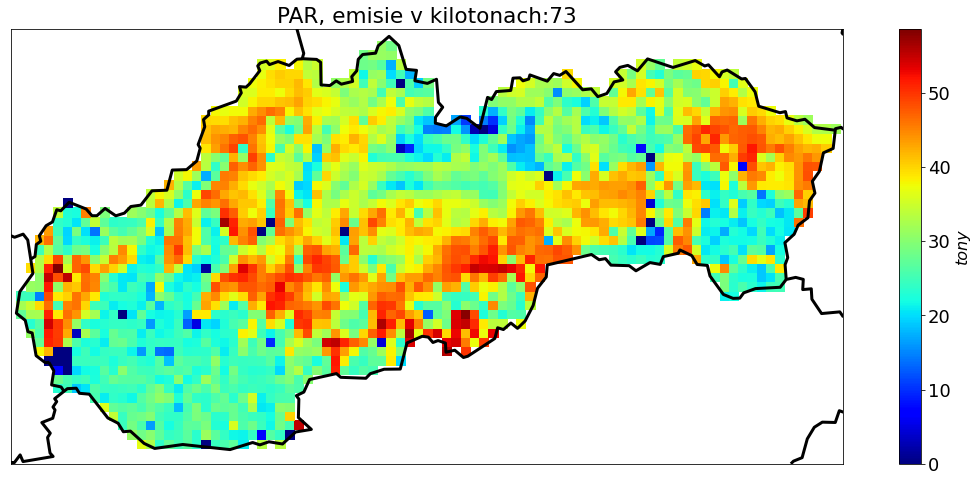

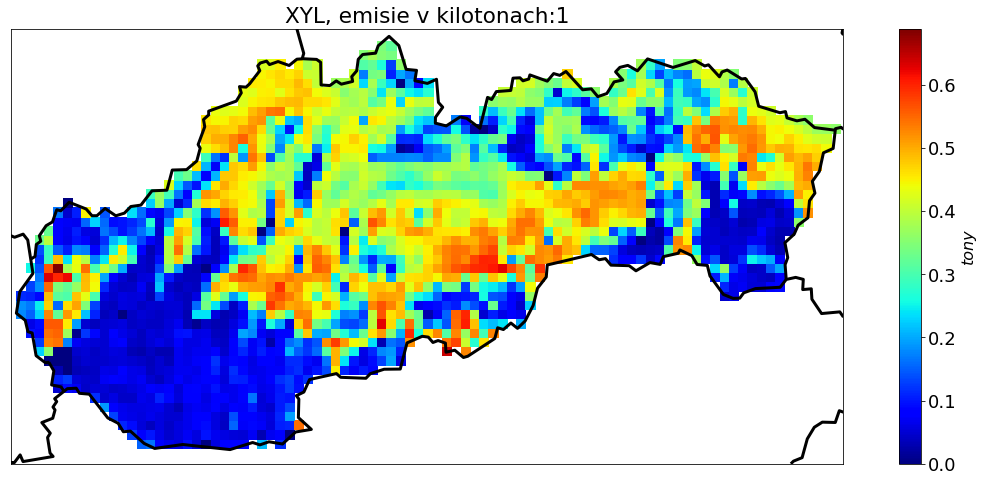

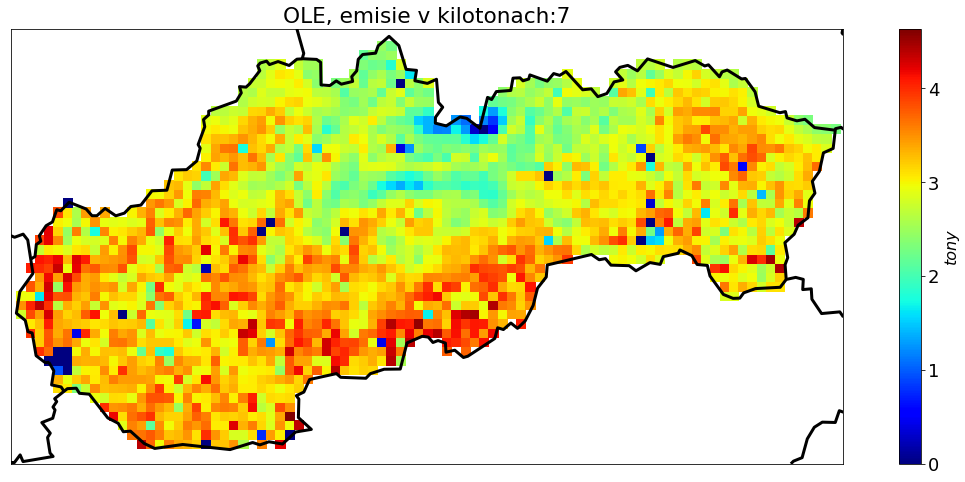

...

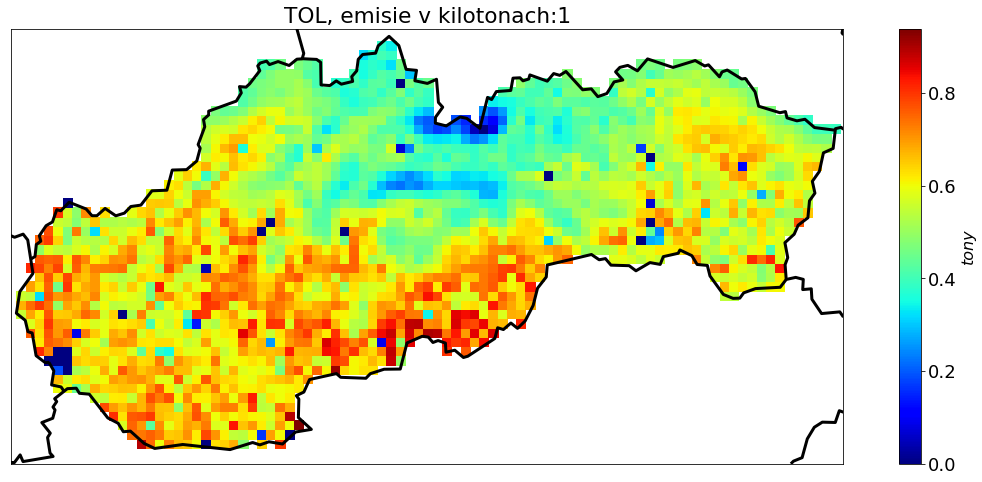

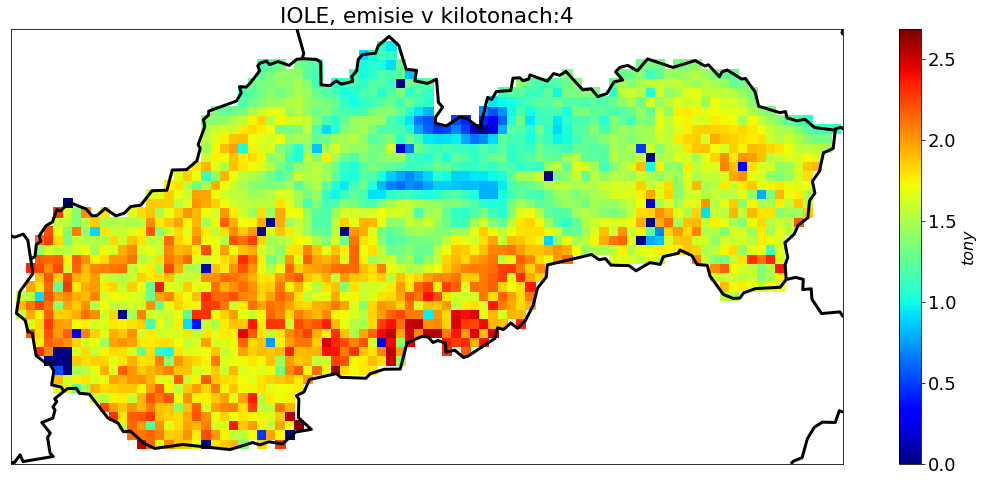

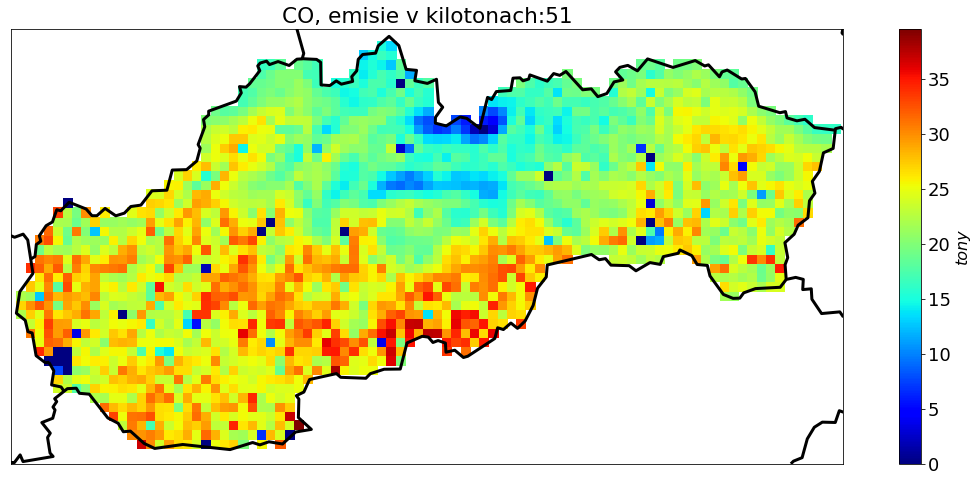

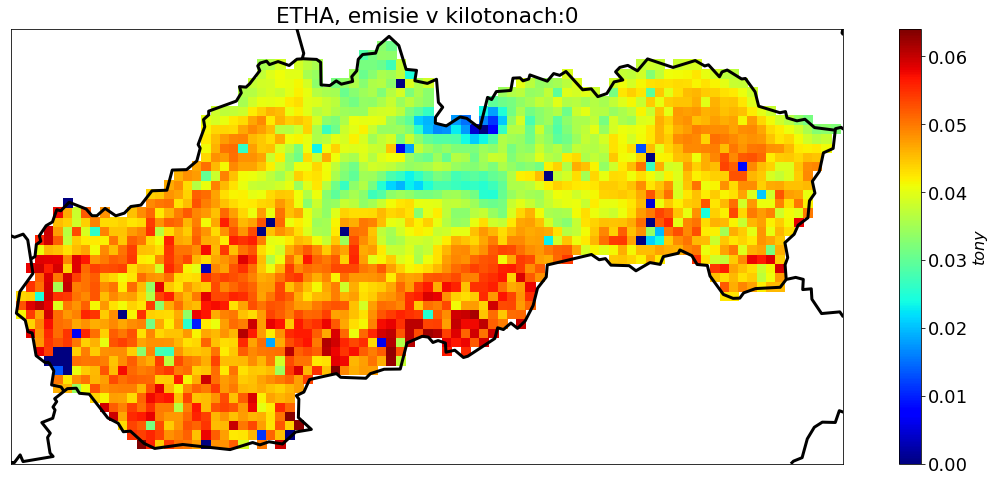

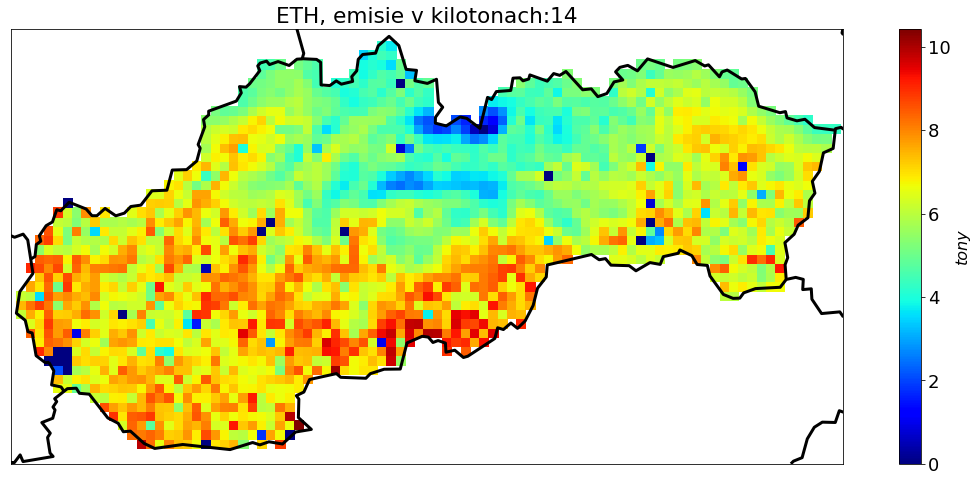

In [12]:
dic_megan={}
for var in meg.data_vars: 
    if var  not in ['GDAY','NH3']:
        #print(var, np.nansum(meg[var].data))
        dic_megan[var] = np.nansum(meg[var].data)
        mapb.drawcountries(linewidth=3)
        # np.sum(clipped2.emiss_bio_monthly.data, axis=0)   

        b=mapb.pcolormesh(lond02[12:57,88:178],latd02[12:57,88:178],np.sum(meg[var].data[:,0,:,:], axis=0)*dic_konv[var]*3600/1000000,latlon=True,cmap=plt.cm.jet)# vmin=0,vmax=50)

        cb=plt.colorbar(b,label='tony')
        #cb.set_ticks()

        cb.ax.yaxis.label.set_font_properties(font)
        plt.title(f"{var}, emisie v kilotonach:{dic_meg_ton[f'{var}:{dic_def[var]}']/1000:.0f}")

        #plt.savefig('/data/oko/ochrana_ovzdusia_2019/hustota_obrazok', dpi=300, bbox_inches='tight')
        plt.show()
        plt.close() 


## porovnanie CAMS a Jurov Megan

Ked si vykreslime rocne emisie prostrednictovom grafov pre CAMS a Megan mame rozne nazvy latok a cisiel, vysledky su v kilotonach:

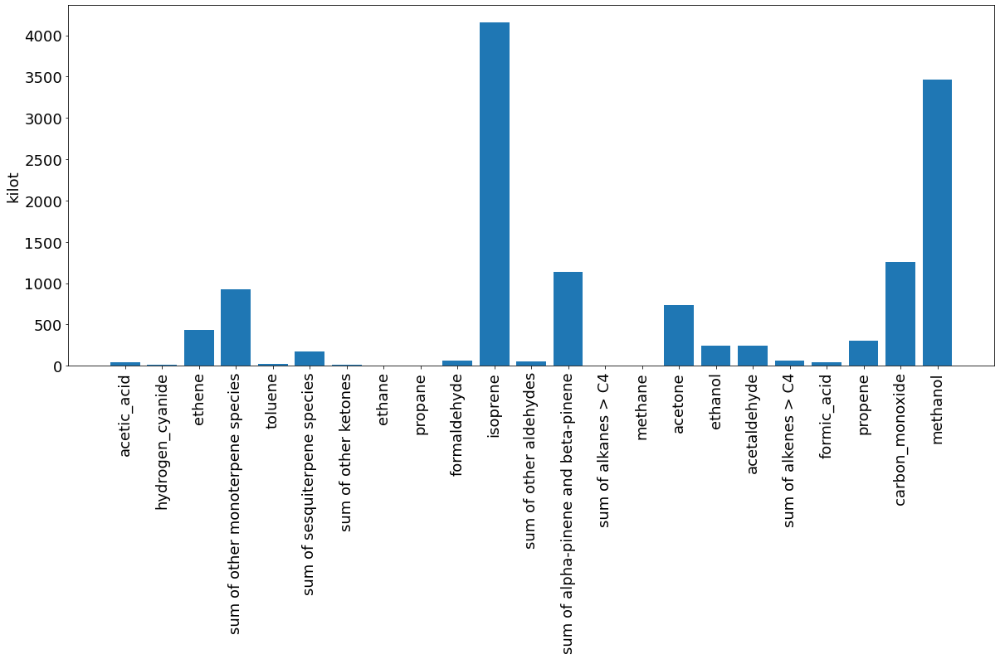

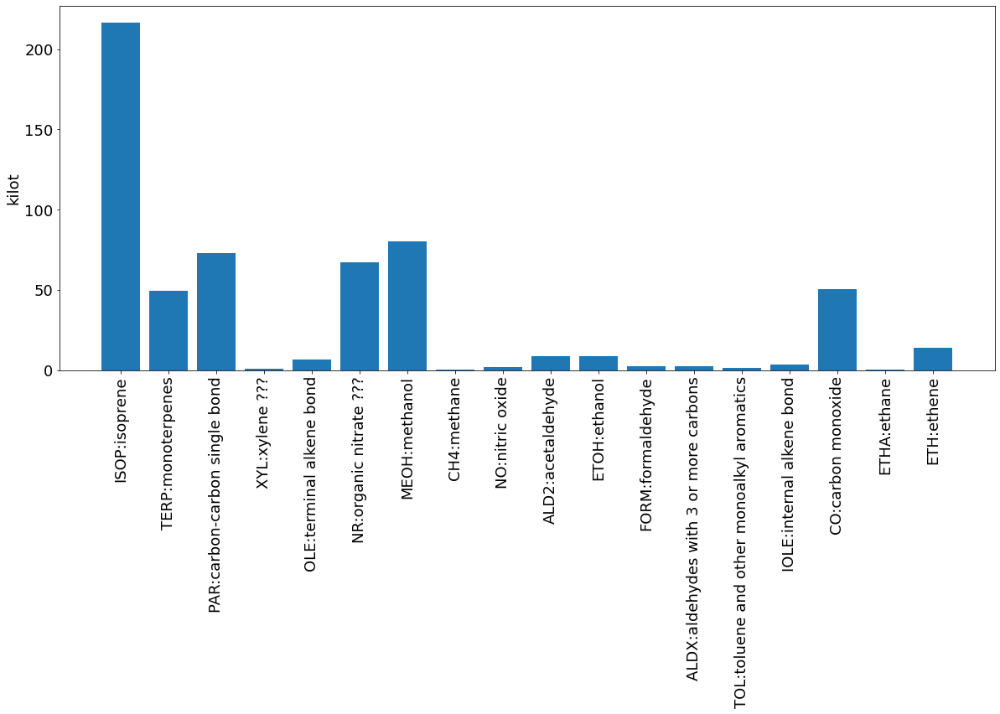

In [13]:
plt.bar(CAMS_emisie_v_tonach.keys(),  np.array(list(CAMS_emisie_v_tonach.values()))/1000 )
plt.xticks( rotation='vertical')
plt.ylabel('kilot')
plt.show()
plt.close()

plt.bar(dic_meg_ton.keys(), np.array(list(dic_meg_ton.values()))/1000  )
plt.xticks( rotation='vertical')
plt.ylabel('kilot')
plt.show()
plt.close()

In [14]:
print('Model CAMS dava pre vsetky biogenne emisie na Slovensku hodnotu dokopy (v kilotonach)')
print(f'{np.sum(list(CAMS_emisie_v_tonach.values()))/1000:.0f}')
print('Jurajov Megan dava pre vsetky biogenne emisie na Slovensku hodnotu dokopy (v kilotonach)')
print(f'{np.sum(list(dic_meg_ton.values()))/1000:.0f}')    
print('CAMS/MEGAN')
print(f'{np.sum(list(CAMS_emisie_v_tonach.values()))/np.sum(list(dic_meg_ton.values())):.1f}')   

Model CAMS dava pre vsetky biogenne emisie na Slovensku hodnotu dokopy (v kilotonach)
13377
Jurajov Megan dava pre vsetky biogenne emisie na Slovensku hodnotu dokopy (v kilotonach)
586
CAMS/MEGAN
22.8


### priradenie CAMS MEGAN

In [15]:
#CAMS obsahuje
CAMS_MEGAN={'ethene':'ETH:ethene',
 'sum of other monoterpene species':'TERP:monoterpenes',
 'toluene':'TOL:toluene and other monoalkyl aromatics',
 'ethane':'ETHA:ethane',
 'formaldehyde':'FORM:formaldehyde',
 'isoprene':'ISOP:isoprene',
 'sum of other aldehydes':'ALDX:aldehydes with 3 or more carbons',
 'methane':'CH4:methane',
 'ethanol':'ETOH:ethanol',
 'acetaldehyde':'ALD2:acetaldehyde',
 'carbon_monoxide':'CO:carbon monoxide',
 'methanol':'MEOH:methanol'}

CAMS_iba= ['acetic_acid',
'hydrogen_cyanide',  
'acetone',
'propane',    
'sum of sesquiterpene species',
'sum of other ketones',
'sum of alkenes > C4',
'formic_acid',
'propene',
'sum of alpha-pinene and beta-pinene']
    
Megan_iba=['PAR:carbon-carbon single bond',
 'XYL:xylene ???',
 'OLE:terminal alkene bond',
 'NR:organic nitrate ???',
 'NO:nitric oxide',
 'IOLE:internal alkene bond']


In [16]:
for i in CAMS_emisie_v_tonach:
    if i in CAMS_MEGAN:
        print(f'############## {i} ###############')
        print('CAMS (v kilotonach) :'+f'{CAMS_emisie_v_tonach[i]/1000:.0f}')
       
        print('Megan (v kilotonach):'+f'{dic_meg_ton[CAMS_MEGAN[i]]/1000:.0f}')
   
        print('CAMS/MEGAN:'+f'{CAMS_emisie_v_tonach[i]/dic_meg_ton[CAMS_MEGAN[i]]:.1f}')

print('##############################################################')
pom_sum = 0    
for i in CAMS_emisie_v_tonach:
    if i in CAMS_iba:  
       pom_sum+=CAMS_emisie_v_tonach[i]/1000 

print('Suma emisii, ktore su len v CAMS a nie v MEGAN (v kilotonach):'+f'{pom_sum:.0f}')   
print(CAMS_iba)
print('##############################################################')
pom_sum = 0    
for i in dic_meg_ton:
    if i in Megan_iba:  
       pom_sum+=dic_meg_ton[i]/1000 

print('Suma emisii, ktore su len v Megan a nie v CAMS (v kilotonach):'+f'{pom_sum:.0f}')   
print(Megan_iba)

############## ethene ###############
CAMS (v kilotonach) :437
Megan (v kilotonach):14
CAMS/MEGAN:31.8
############## sum of other monoterpene species ###############
CAMS (v kilotonach) :924
Megan (v kilotonach):49
CAMS/MEGAN:18.7
############## toluene ###############
CAMS (v kilotonach) :23
Megan (v kilotonach):1
CAMS/MEGAN:18.2
############## ethane ###############
CAMS (v kilotonach) :6
Megan (v kilotonach):0
CAMS/MEGAN:64.9
############## formaldehyde ###############
CAMS (v kilotonach) :59
Megan (v kilotonach):2
CAMS/MEGAN:26.8
############## isoprene ###############
CAMS (v kilotonach) :4156
Megan (v kilotonach):216
CAMS/MEGAN:19.2
############## sum of other aldehydes ###############
CAMS (v kilotonach) :49
Megan (v kilotonach):3
CAMS/MEGAN:18.7
############## methane ###############
CAMS (v kilotonach) :3
Megan (v kilotonach):0
CAMS/MEGAN:65.1
############## ethanol ###############
CAMS (v kilotonach) :238
Megan (v kilotonach):9
CAMS/MEGAN:27.1
############## acetaldehyde ###

# Biogénne emisie v modeli CMAQ

Model CMAQ počíta emisie pomocou BEIS3 modelu, co je alternativa k MEGAN


princíp je nasledovný:

na základe land use dát podľa klasifikácie beld4 sa vypočítajú priemerné ročné zimné a letné emisie pre nasledovné látky:

```
ISOP 	Isoprene
MBO 	2-methyl-3-buten-2-ol
METH 	Methanol
ETHE 	Ethene
PROPE 	Propene
ETHO 	Ethanol
ACET 	Acetone
HEXA 	Hexanal
HEXE 	Hexenol
HEXY 	Hexenylacetate
FORM 	Formaldehyde
ACTAL 	Acetaldehyde
BUTE 	Butene
ETHA 	Ethane
FORAC 	Formic acid
ACTAC 	Acetic acid
BUTO 	Butenone (aka methyl vinyl ketone)
CO 	Carbon monoxide
ORVOC 	Other reactive VOCs
NO 	Nitric oxide
LAI 	Leaf area indices
SESQT 	Sesquiterpene
MONO 	Monoterpenes
APIN 	Alpha-pinene
BPIN 	Beta-pinene
D3CAR 	Delta-3-carene
DLIM 	D-limonene
CAMPH 	Camphene
MYRC 	Myrcene
ATERP 	Alpha-terpinene
BPHE 	Beta-phellandrene
SABI 	Sabinene
PCYM 	P-cymene
OCIM 	Ocimene
ATHU 	Alpha-thujene
TRPO 	Terpinolene
GTERP 	Gamma-terpinene
```
Pričom priradenie je definované v BFAC súbore.
Používajú sa nasledovné land use dáta  podľa metodiky beld4:

In [22]:
import pandas as pd
b3fac=pd.read_csv('/data/oko/dusan/smoke/data/ge_dat/b360fac_beld4_csv_nlcd2006.txt', names=['beld4_name','type','units','factor'])
print(b3fac['beld4_name'].unique())

['NLCD_11' 'NLCD_12' 'NLCD_21' 'NLCD_22' 'NLCD_23' 'NLCD_24' 'NLCD_31'
 'NLCD_32' 'NLCD_41' 'NLCD_42' 'NLCD_43' 'NLCD_51' 'NLCD_52' 'NLCD_71'
 'NLCD_72' 'NLCD_73' 'NLCD_74' 'NLCD_75' 'NLCD_81' 'NLCD_82' 'NLCD_90'
 'NLCD_91' 'NLCD_92' 'NLCD_93' 'NLCD_94' 'NLCD_95' 'NLCD_96' 'NLCD_97'
 'NLCD_98' 'NLCD_99' 'MODIS_0' 'MODIS_1' 'MODIS_2' 'MODIS_3' 'MODIS_4'
 'MODIS_5' 'MODIS_6' 'MODIS_7' 'MODIS_8' 'MODIS_9' 'MODIS_10' 'MODIS_11'
 'MODIS_12' 'MODIS_13' 'MODIS_14' 'MODIS_15' 'MODIS_16' 'MODIS_17'
 'MODIS_254' 'MODIS_255' 'Hay' 'Hay_ir' 'Alfalfa' 'Alfalfa_ir'
 'Other_Grass' 'Other_Grass_ir' 'Barley' 'Barley_ir' 'BeansEdible'
 'BeansEdible_ir' 'CornGrain' 'CornGrain_ir' 'CornSilage' 'CornSilage_ir'
 'Cotton' 'Cotton_ir' 'Oats' 'Oats_ir' 'Peanuts' 'Peanuts_ir' 'Potatoes'
 'Potatoes_ir' 'Rice' 'Rice_ir' 'Rye' 'Rye_ir' 'SorghumGrain'
 'SorghumGrain_ir' 'SorghumSilage' 'SorghumSilage_ir' 'Soybeans'
 'Soybeans_ir' 'Wheat_Spring' 'Wheat_Spring_ir' 'Wheat_Winter'
 'Wheat_Winter_ir' 'Other_Crop' 'Other

CMAQ dostane konkrétne takéto polia ročných emisií a leaf area indexov:

In [21]:
import netCDF4
vlado1=netCDF4.Dataset('/data/oko/dusan/emisie/B3GRD_D02.nc')
print(list(vlado1.variables.keys())[1:])

['AVG_ISOPS', 'AVG_ISOPW', 'LAI_ISOPS', 'LAI_ISOPW', 'AVG_MBOS', 'AVG_MBOW', 'LAI_MBOS', 'LAI_MBOW', 'AVG_METHS', 'AVG_METHW', 'LAI_METHS', 'LAI_METHW', 'AVG_APINS', 'AVG_APINW', 'AVG_BPINS', 'AVG_BPINW', 'AVG_D3CARS', 'AVG_D3CARW', 'AVG_DLIMS', 'AVG_DLIMW', 'AVG_CAMPHS', 'AVG_CAMPHW', 'AVG_MYRCS', 'AVG_MYRCW', 'AVG_ATERPS', 'AVG_ATERPW', 'AVG_BPHES', 'AVG_BPHEW', 'AVG_SABIS', 'AVG_SABIW', 'AVG_PCYMS', 'AVG_PCYMW', 'AVG_OCIMS', 'AVG_OCIMW', 'AVG_ATHUS', 'AVG_ATHUW', 'AVG_TRPOS', 'AVG_TRPOW', 'AVG_GTERPS', 'AVG_GTERPW', 'AVG_ETHES', 'AVG_ETHEW', 'AVG_PROPES', 'AVG_PROPEW', 'AVG_ETHOS', 'AVG_ETHOW', 'AVG_ACETS', 'AVG_ACETW', 'AVG_HEXAS', 'AVG_HEXAW', 'AVG_HEXES', 'AVG_HEXEW', 'AVG_HEXYS', 'AVG_HEXYW', 'AVG_FORMS', 'AVG_FORMW', 'AVG_ACTALS', 'AVG_ACTALW', 'AVG_BUTES', 'AVG_BUTEW', 'AVG_ETHAS', 'AVG_ETHAW', 'AVG_FORACS', 'AVG_FORACW', 'AVG_ACTACS', 'AVG_ACTACW', 'AVG_BUTOS', 'AVG_BUTOW', 'AVG_COS', 'AVG_COW', 'AVG_ORVOCS', 'AVG_ORVOCW', 'AVG_SESQTS', 'AVG_SESQTW', 'AVG_NOAG_GROW', 'AVG_NOA

Kde AVG, oznacuje priemerné ročné emisné toky v gC za h, S a W na konci letné resp zimné emisie,
LAI je LEAF area index pre danu latku, NOAG_GROW je NO z polnoh. pocas sezony,
'NOAG_NONGROW' je NO z polnoh. mimo sezony rastu, NONONAG je NO bez polnohospodarstva .

CMAQ si pomocou tohto súboru vypočíta hodinové emisie 22 latok na základe meteorologických podmienok, konečné biogénne emisie modelu CMAQv5.3.1 teda sú ([tu](https://github.com/USEPA/CMAQ/blob/master/CCTM/src/MECHS/mechanism_information/cb6r3_ae7_aq/cb6r3_ae7_aq_species_table.md) je tabulka názvov mólových hmotností  ):

In [20]:
cmaq1=netCDF4.Dataset('/data/oko/dusan/emisie/CCTM_B3GTS_S_v531_gcc_small_sk2_biog_20170102.nc')
list(cmaq1.variables.keys())[1:]

['ISOP',
 'OLE',
 'PAR',
 'MEOH',
 'APIN',
 'TERP',
 'ETH',
 'ETOH',
 'ACET',
 'ALDX',
 'IOLE',
 'FORM',
 'FORM_PRIMARY',
 'ALD2',
 'ALD2_PRIMARY',
 'ETHA',
 'FACD',
 'AACD',
 'KET',
 'CO',
 'SESQ',
 'NO']

##  Konkrétny výpočet pomocou Modis dát

teraz si teda ukážme ako sme zatiaľ postupovali:
Vlado pripravil MODIS vrstvy, takze namiesto celej skaly BELD4 mame len modis vrstvy, tu sú:

In [23]:
mod="""MODIS_0=water
MODIS_1=Evergreen needleleaf forest
MODIS_2=Evergreen broadleaf forest
MODIS_3=Deciduous needleleaf forest
MODIS_4=Deciduous broadleaf forest
MODIS_5=Mixed forests
MODIS_6=Closed shrublands
MODIS_7=Open shrublands
MODIS_8=Woody savannas
MODIS_9=Savannas
MODIS_10=Grasslands
MODIS_11=Permanent wetlands
MODIS_12=Croplands
MODIS_13=Urban and built up
MODIS_14=Cropland / natural vegetation mosaic
MODIS_15=Permanent snow and ice
MODIS_16=Barren or sparsely vegetated
MODIS_17=IGBP water
MODIS_254=Unclassified
MODIS_255=Fill value (normally ocean water)"""
dic_prek={x.split('=')[0] : x.split('=')[1] for x in mod.split('\n')}

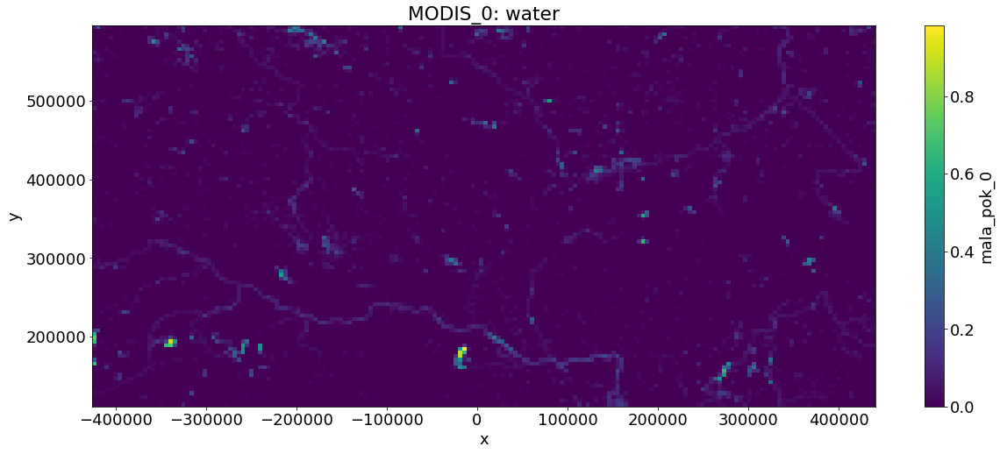

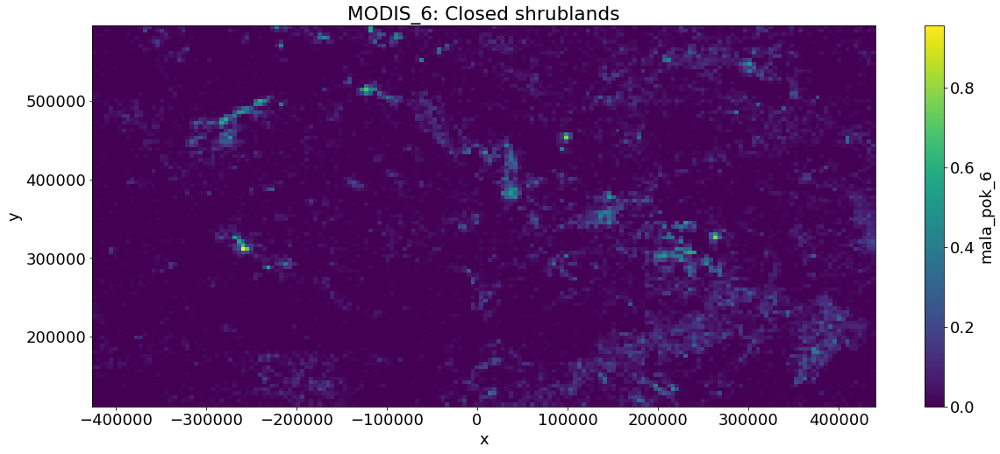

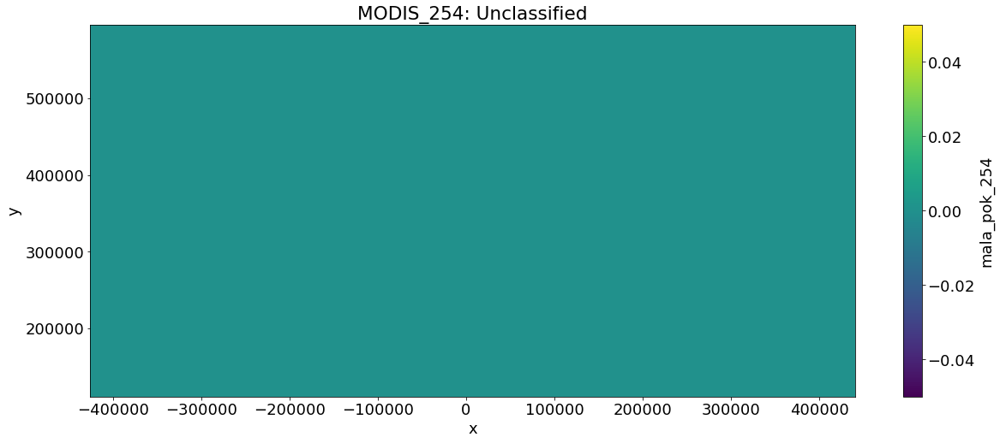

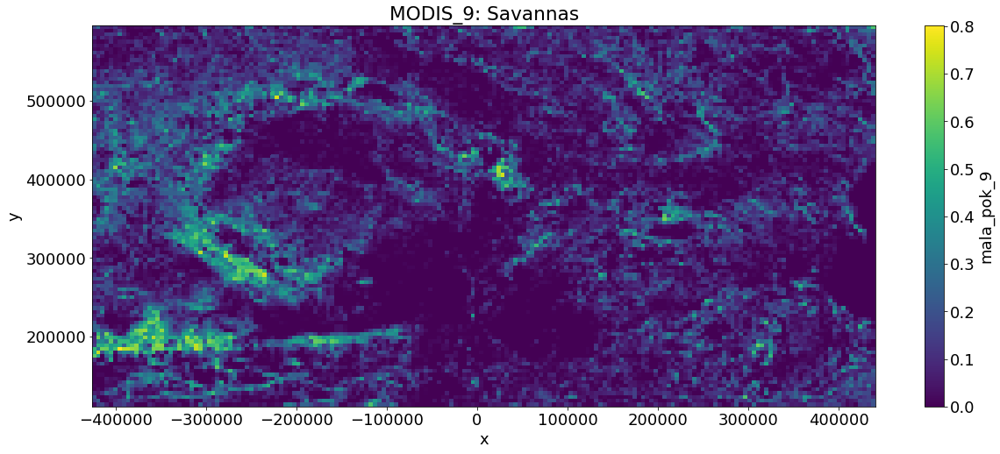

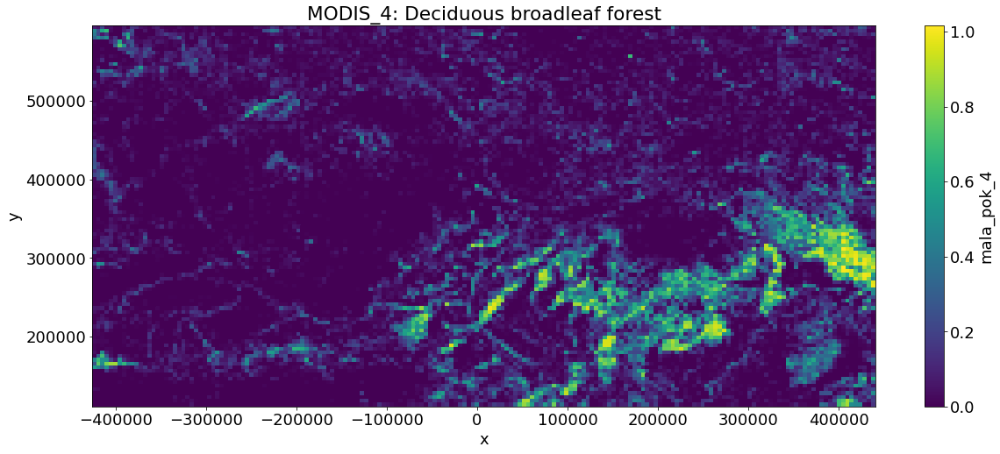

...

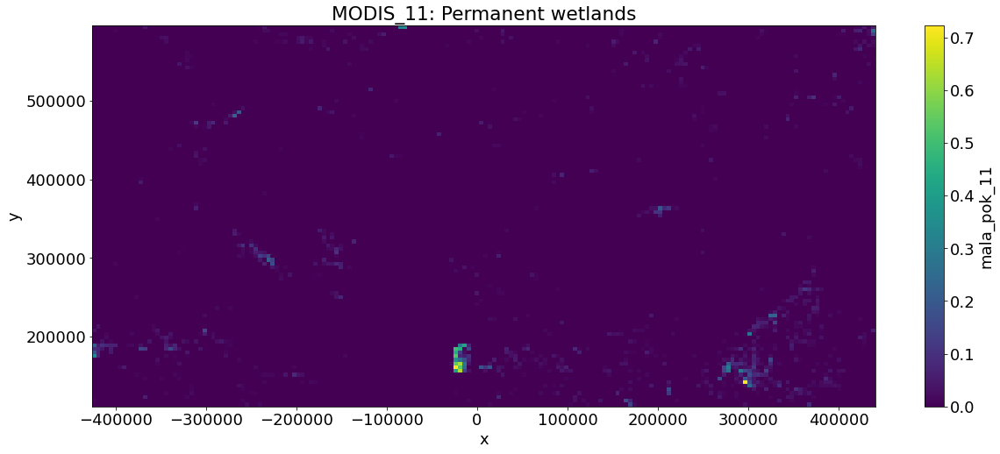

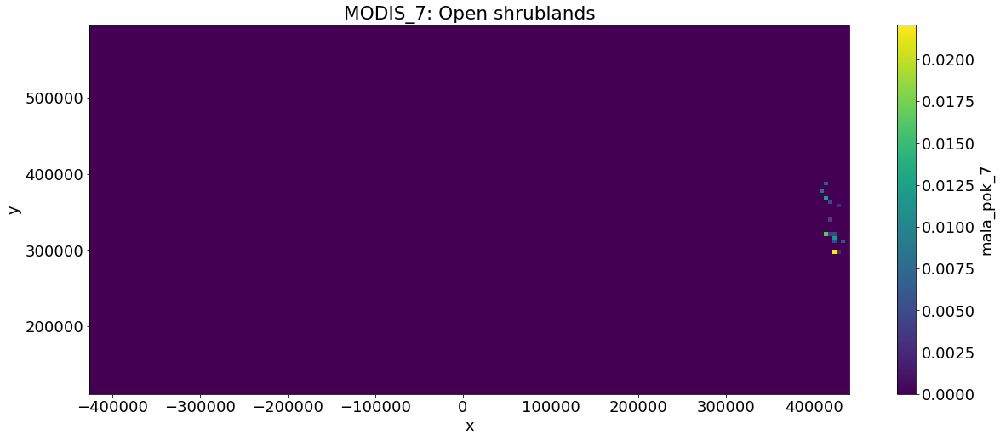

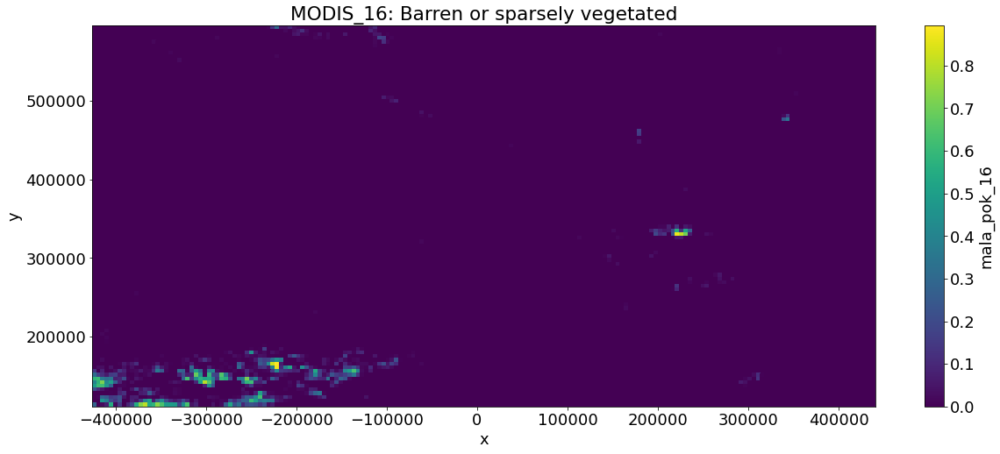

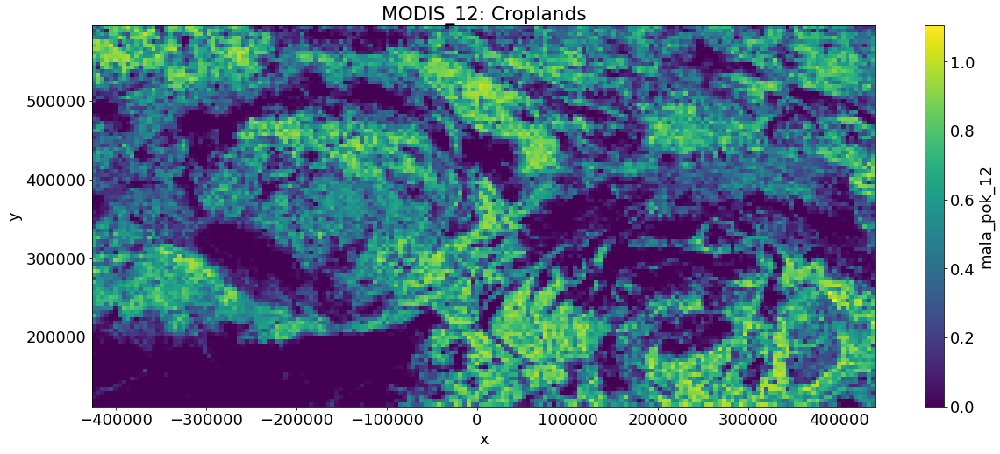

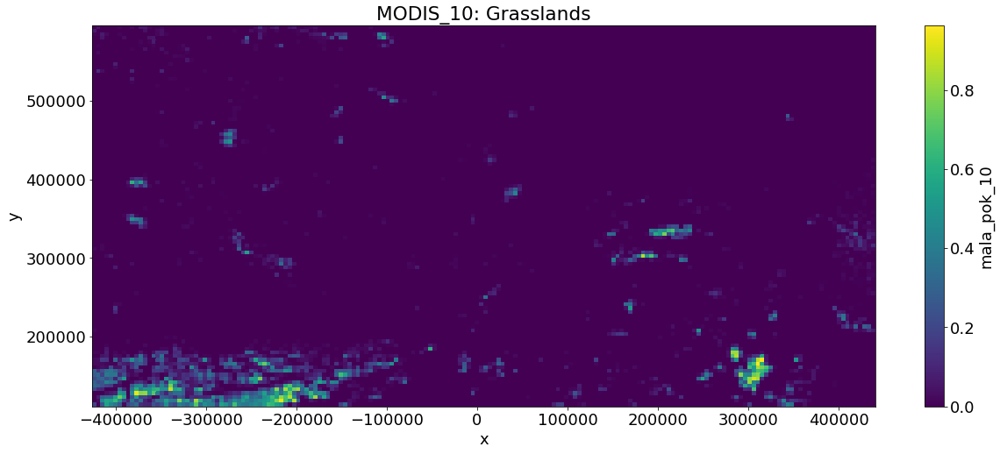

In [24]:
import rioxarray
import os
import matplotlib.pyplot as plt

beld4={}
for i in os.listdir('/data/oko/dusan/emisie/vlado_modis'):
    vrstva = rioxarray.open_rasterio('/data/oko/dusan/emisie/vlado_modis/'+i)
    beld4['MODIS_'+i[10:]]=vrstva
    rioxarray.open_rasterio('/data/oko/dusan/emisie/vlado_modis/'+i).plot() 
    plt.title('MODIS_'+i[10:]+f": {dic_prek['MODIS_'+i[10:]]}")
    plt.show()
    plt.close()

Z nich sme si vypočítali vstupný súbor (fejk normbais.f program) pre CMAQ:

In [25]:
import xarray
b3grd=xarray.open_dataset('/data/oko/dusan/emisie/B3GRD_D02.nc')

In [26]:
import sys
sys.path.append('/home/KOL/p6065/python-scripts/core/')

from gridParams import *

from modelParams import *

from mpl_toolkits.basemap import Basemap
import matplotlib.pyplot as plt
import matplotlib
from matplotlib.colors import from_levels_and_colors
from matplotlib import colors

lond02, latd02 = d02.getCoordsGrids(lonlat=True,center=False)
mapb=Basemap(**d02.basemap_proj)
plt.rcParams['figure.figsize'] = 20,8
plt.rcParams.update({'font.size': 18})
font = matplotlib.font_manager.FontProperties( style='italic', size=16)

selected None or unknown modif, returning: gridcro
modif options: gridcro, mcip, gridbdy, griddotd, griddotu, griddotv


In [27]:
vlado2=netCDF4.Dataset('/data/oko/dusan/emisie/B3GRD_D02_new.nc')

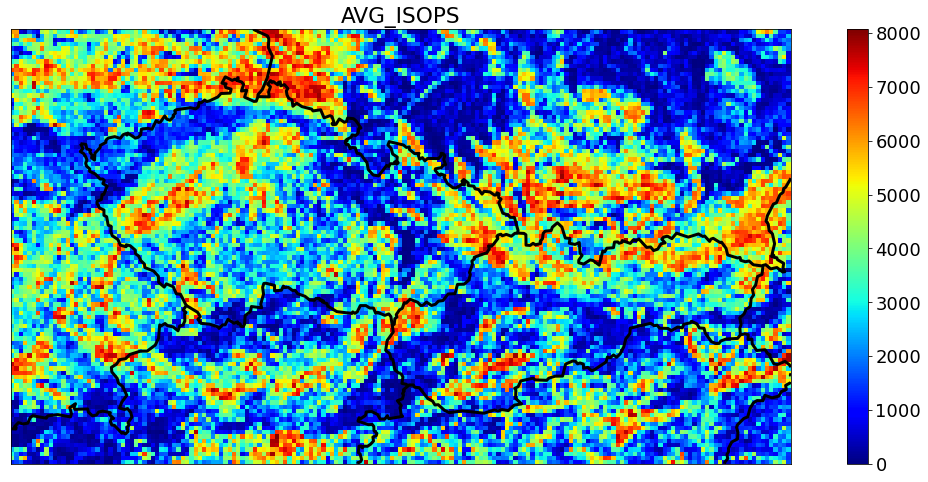

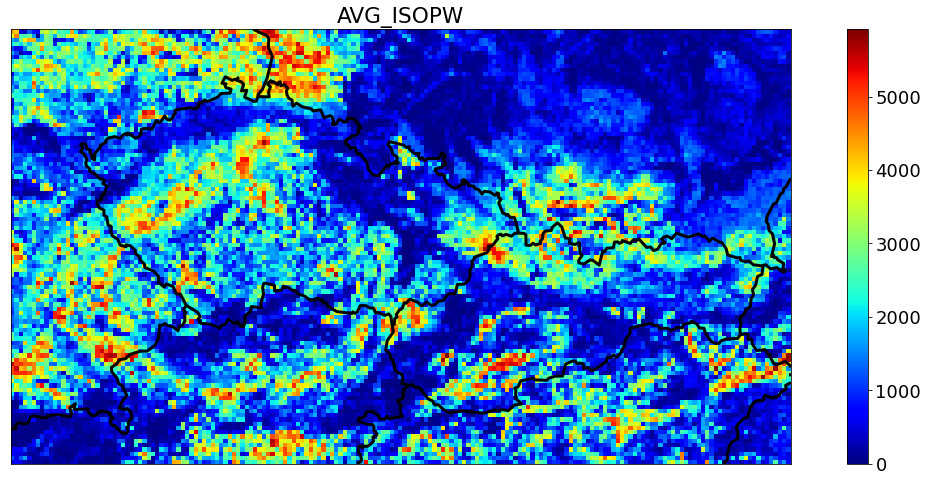

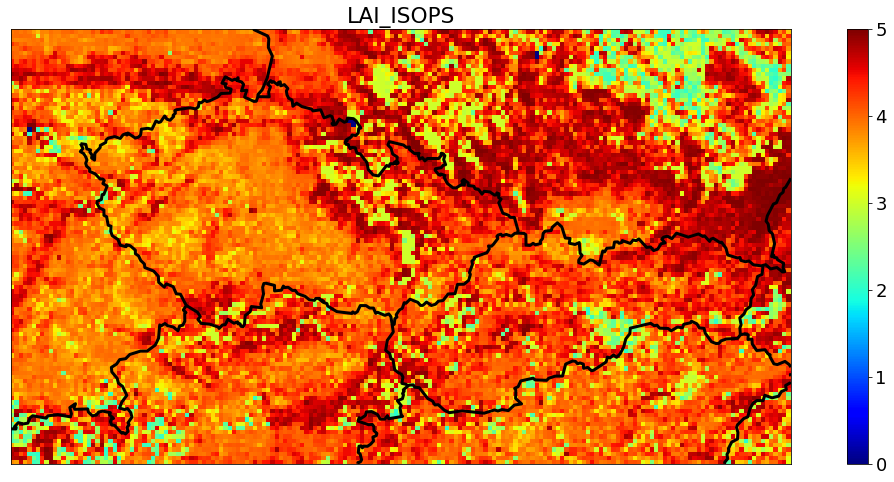

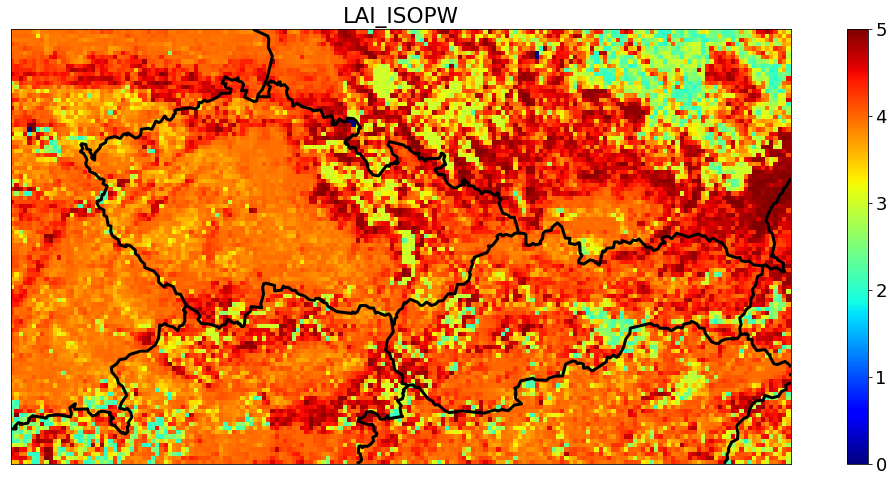

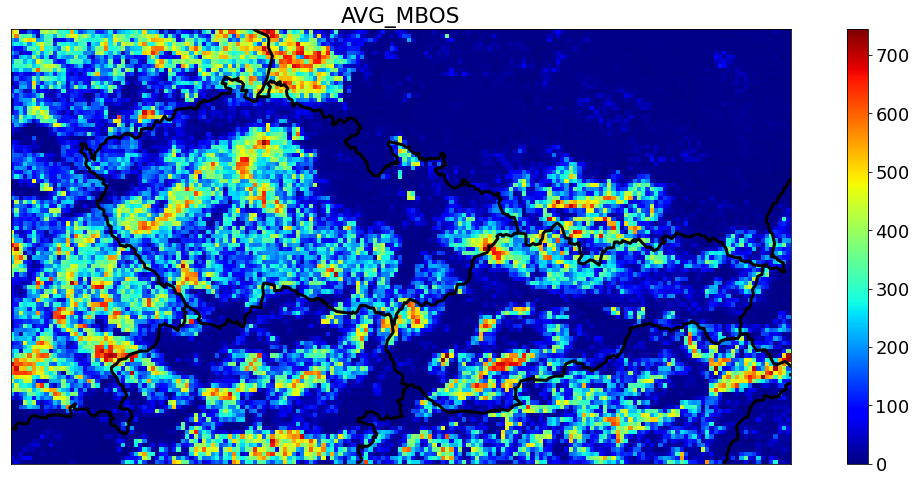

...

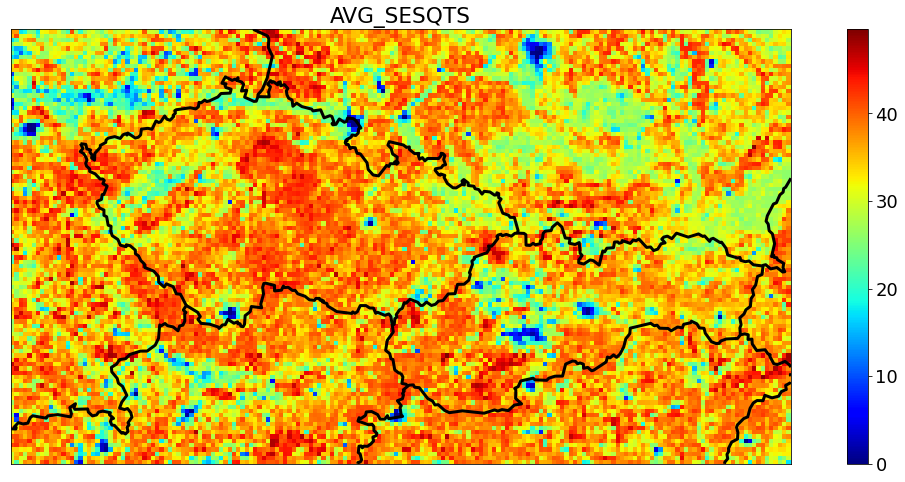

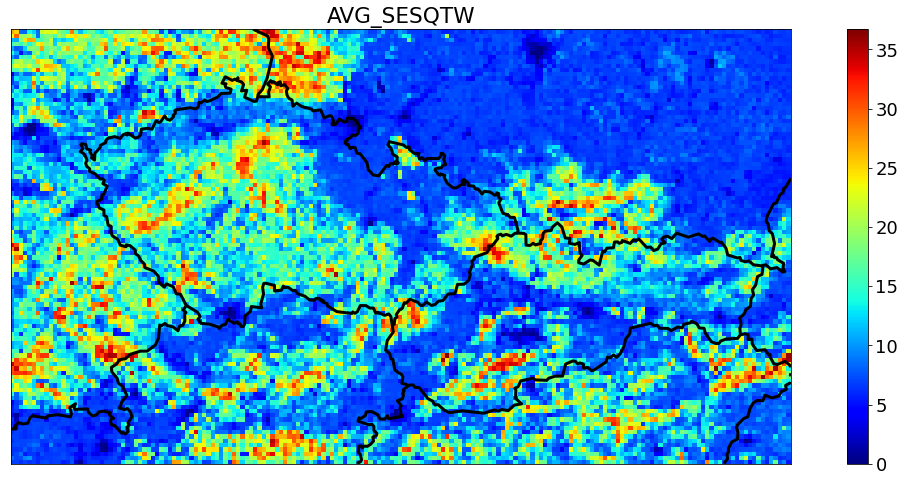

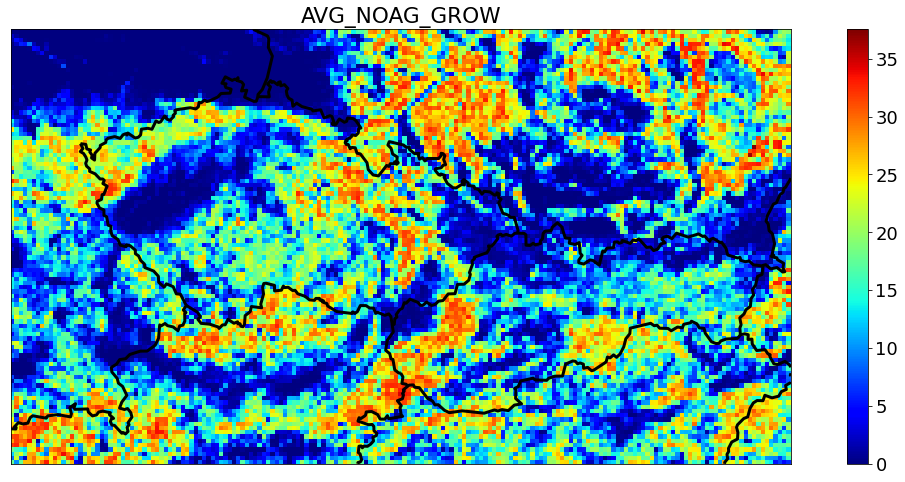

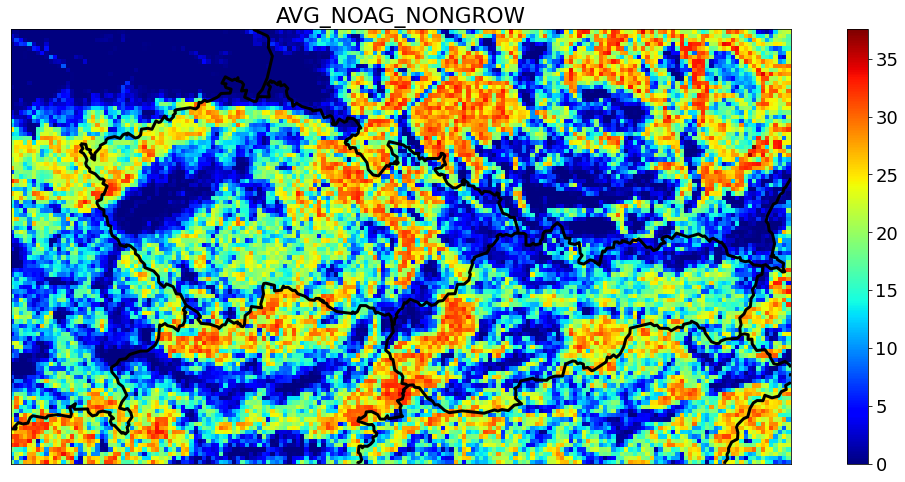

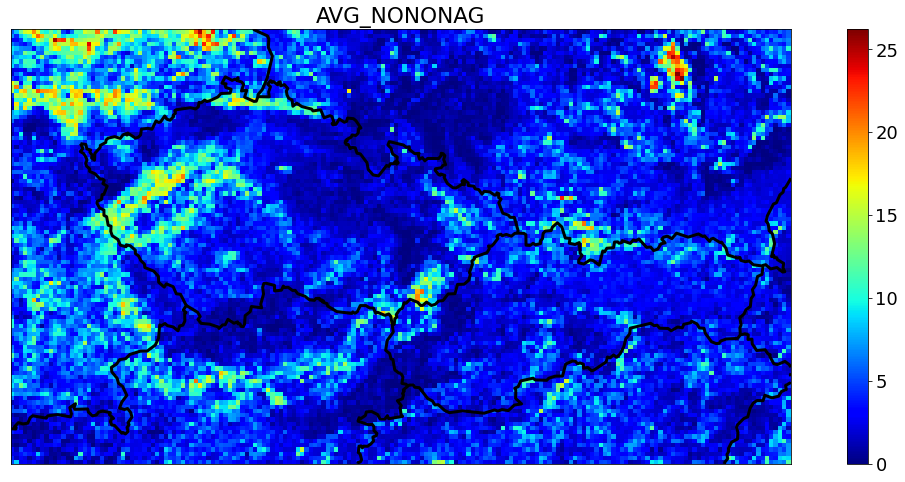

In [28]:
####################################################################################################
for i in list(vlado1.variables.keys())[1:]:
    """
    mapb.drawcountries(linewidth=3)
    b=mapb.pcolormesh(lond02,latd02,vlado1.variables[i][0,0,:],latlon=True,cmap=plt.cm.jet)# vmin=0,vmax=50)

    cb=plt.colorbar(b,label='')
    #cb.set_ticks()

    cb.ax.yaxis.label.set_font_properties(font)
    plt.title(f'{i}')

    #plt.savefig('/data/oko/ochrana_ovzdusia_2019/hustota_obrazok', dpi=300, bbox_inches='tight')
    plt.show()
    plt.close()
    """
####################################################################################################
    mapb.drawcountries(linewidth=3)
    b=mapb.pcolormesh(lond02,latd02,vlado2.variables[i][0,0,:],latlon=True,cmap=plt.cm.jet)# vmin=0,vmax=50)

    cb=plt.colorbar(b,label='')
    #cb.set_ticks()

    cb.ax.yaxis.label.set_font_properties(font)
    plt.title(f'{i}')

    #plt.savefig('/data/oko/ochrana_ovzdusia_2019/hustota_obrazok', dpi=300, bbox_inches='tight')
    plt.show()
    plt.close()
#######################################
    """
    mapb.drawcountries(linewidth=3)
    b=mapb.pcolormesh(lond02,latd02,(vlado2.variables[i][0,0,:]-vlado1.variables[i][0,0,:])/vlado2.variables[i][0,0,:],latlon=True,cmap=plt.cm.jet)# vmin=0,vmax=50)

    cb=plt.colorbar(b,label='')
    #cb.set_ticks()

    cb.ax.yaxis.label.set_font_properties(font)
    plt.title(f'{i}')

    #plt.savefig('/data/oko/ochrana_ovzdusia_2019/hustota_obrazok', dpi=300, bbox_inches='tight')
    plt.show()
    plt.close()
    """

## konečný výsledok modelu CMAQ pre 2.január

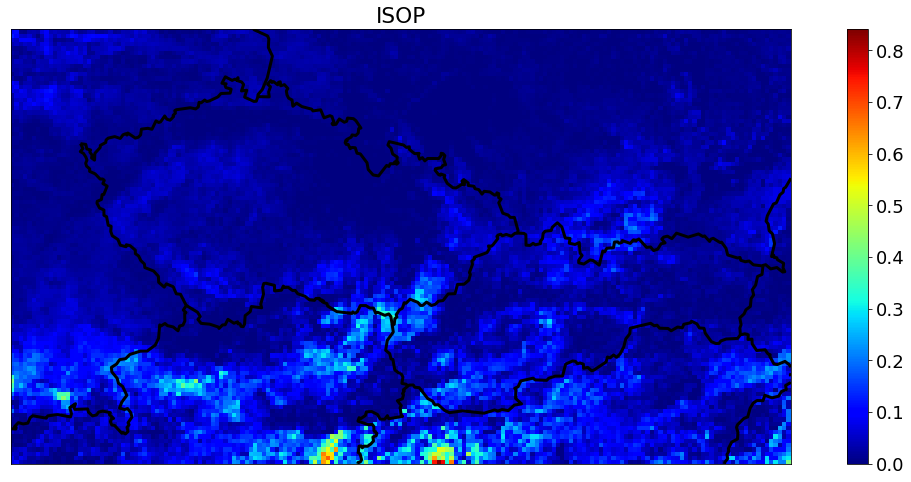

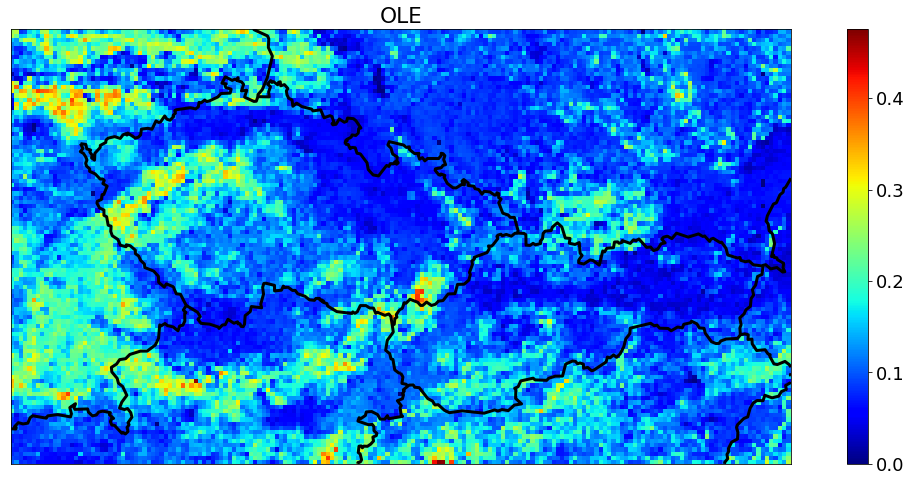

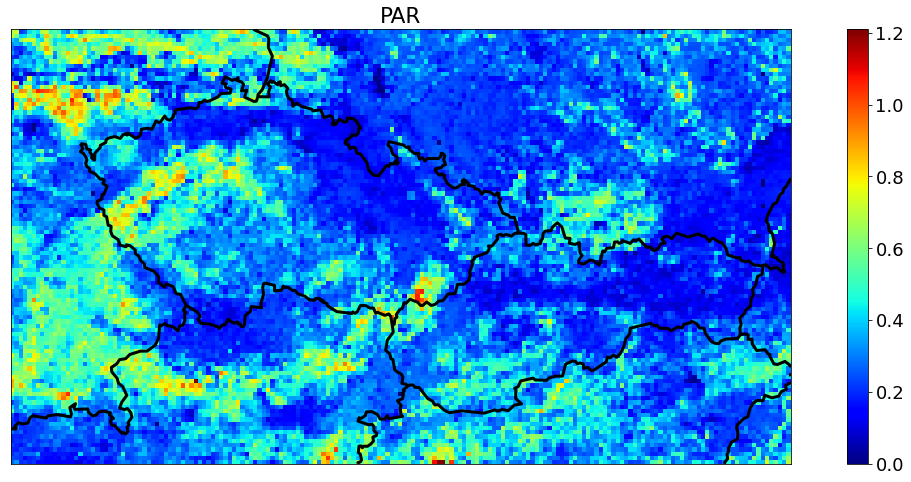

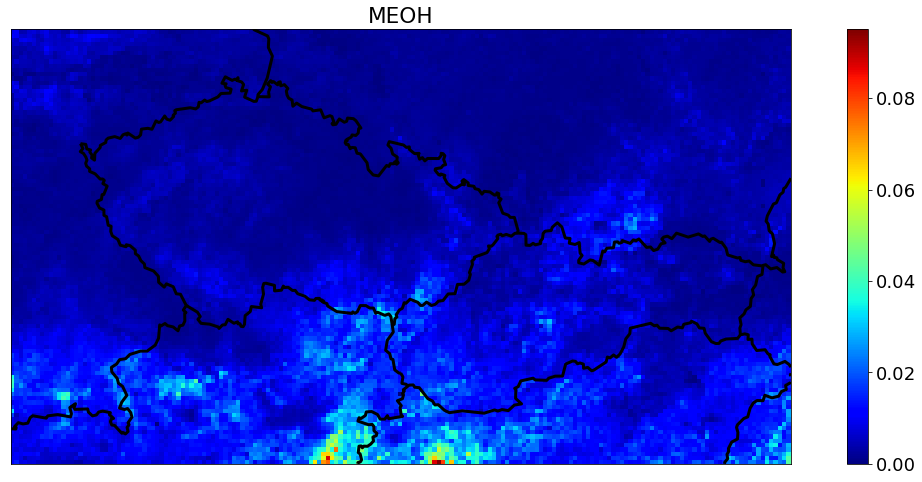

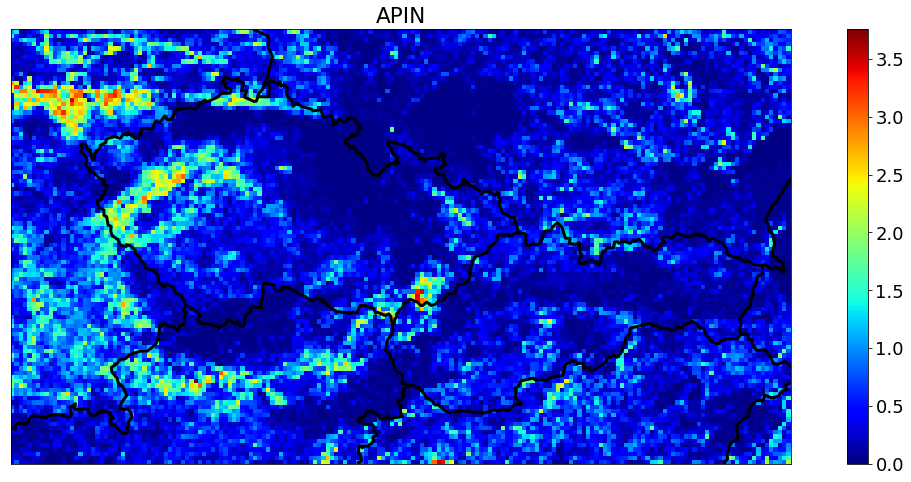

...

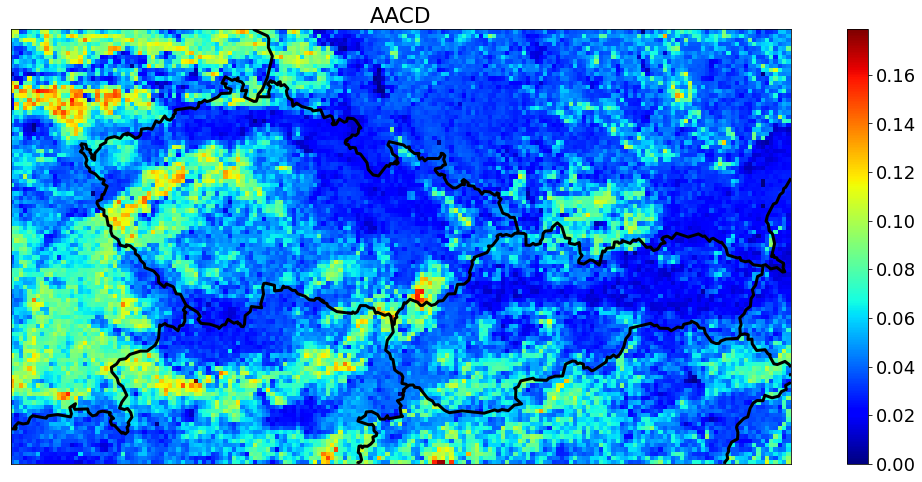

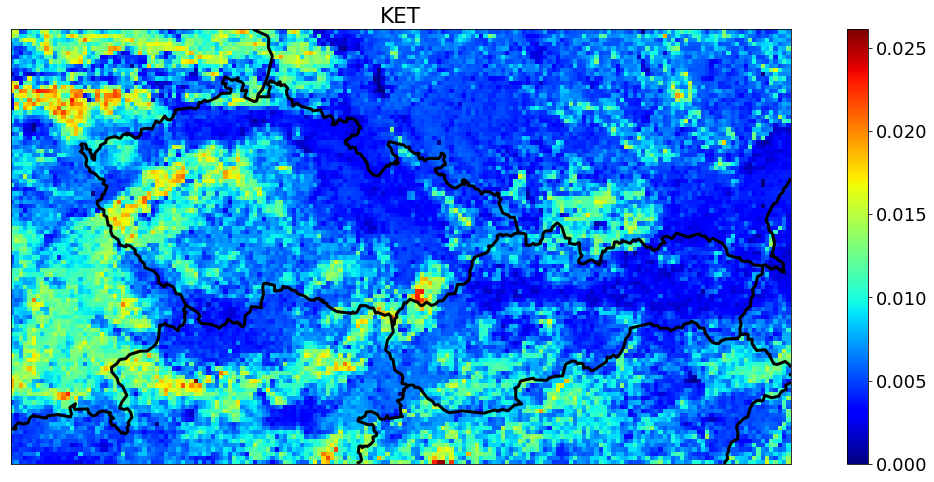

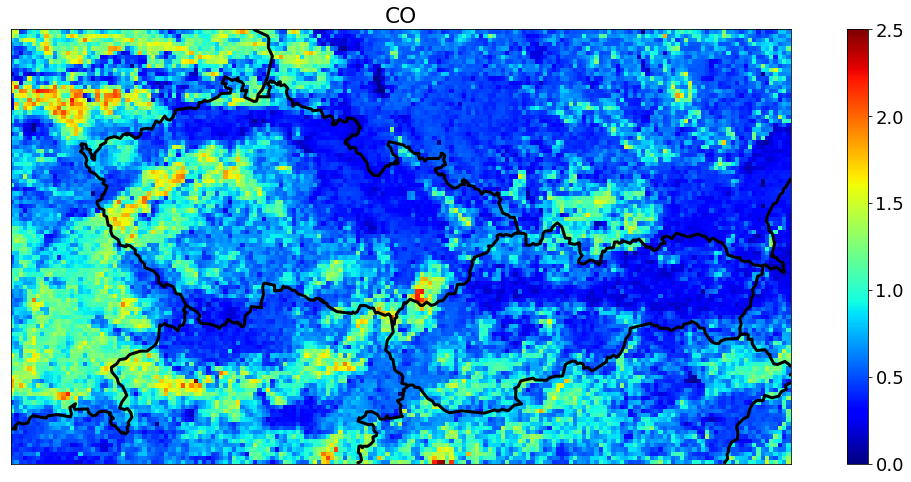

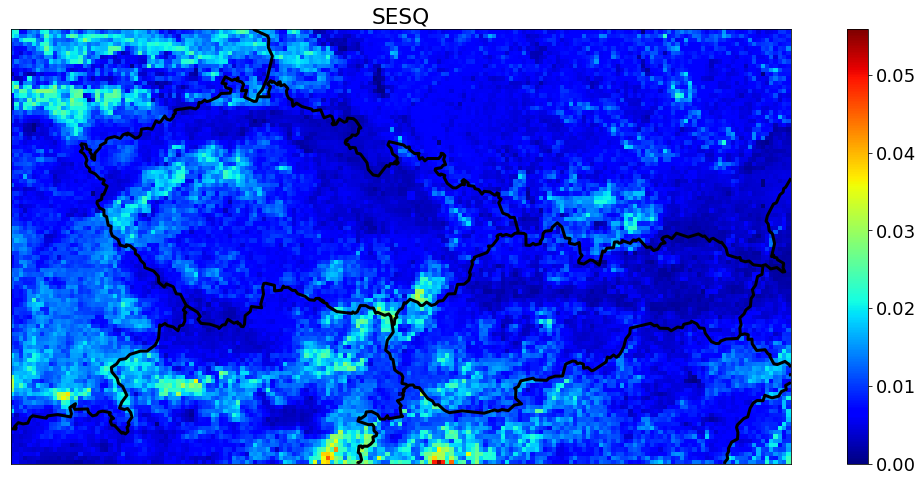

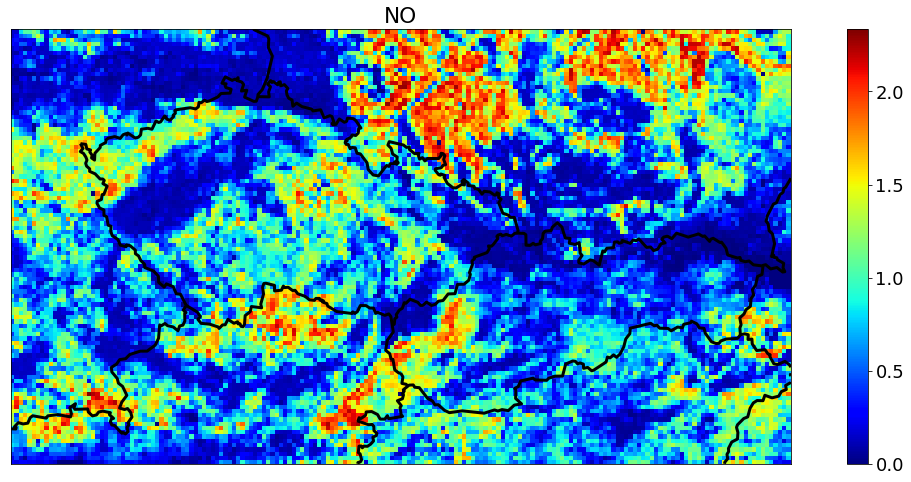

In [29]:
for i in list(cmaq1.variables.keys())[1:]:
    
    mapb.drawcountries(linewidth=3)
    b=mapb.pcolormesh(lond02,latd02,np.sum(cmaq1.variables[i][:,0,:],axis=0),latlon=True,cmap=plt.cm.jet)# vmin=0,vmax=50)

    cb=plt.colorbar(b,label='')
    #cb.set_ticks()

    cb.ax.yaxis.label.set_font_properties(font)
    plt.title(f'{i}')

    #plt.savefig('/data/oko/ochrana_ovzdusia_2019/hustota_obrazok', dpi=300, bbox_inches='tight')
    plt.show()
    plt.close()

## Porovnanie MEGAN A CMAQ-BEIS

Porovnavanie Megan/BEIS emisii sa venovali v clanku [tu](https://www.google.com/url?q=https://www.tandfonline.com/doi/pdf/10.3155/1047-3289.61.1.92&sa=D&source=hangouts&ust=1602684477963000&usg=AFQjCNG0rSozGXZwnly2299OPFrwh3FdmQ)

>MEGAN ma tieto latky, ktore má aj CMAQ/BEIS:

In [30]:
import netCDF4
meg_2j=netCDF4.Dataset('/data/juraj/megan_fume/outputs/2017/d02/meg_CB05_2017-01-02_d02_25.nc')

print('Látky v MEGAN, ktoré sa nachádzajú aj v modeli CMAQ')
for i in list(meg_2j.variables.keys())[1:]:
    if i in list(cmaq1.variables.keys())[1:]:
       print(i)
print('Látky v MEGAN, ktoré nie sú v modeli CMAQ')
for i in list(meg_2j.variables.keys())[1:]:
    if i not in list(cmaq1.variables.keys())[1:]:
       print(i) 
print('Látky v CMAQ, ktoré nie sú v modeli MEGAN')
for i in list(cmaq1.variables.keys())[1:]:
    if i not in list(meg_2j.variables.keys())[1:]:
       print(i)            

Látky v MEGAN, ktoré sa nachádzajú aj v modeli CMAQ
ISOP
TERP
PAR
OLE
MEOH
NO
ALD2
ETOH
FORM
ALDX
IOLE
CO
ETHA
ETH
Látky v MEGAN, ktoré nie sú v modeli CMAQ
XYL
NR
CH4
NH3
TOL
GDAY
Látky v CMAQ, ktoré nie sú v modeli MEGAN
APIN
ACET
FORM_PRIMARY
ALD2_PRIMARY
FACD
AACD
KET
SESQ


## porovnanie CMAQ vs MEGAN pre 2. januar

  ISOP MEG/CMAQ: 4.9248366355896


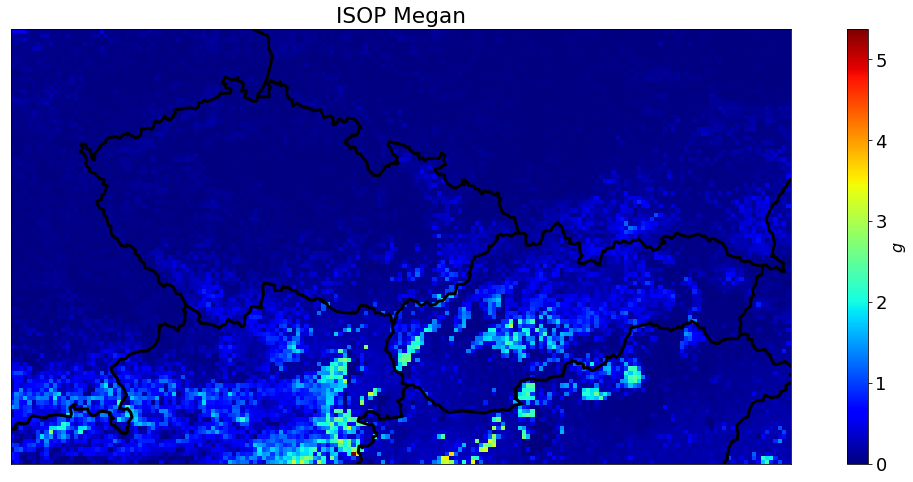

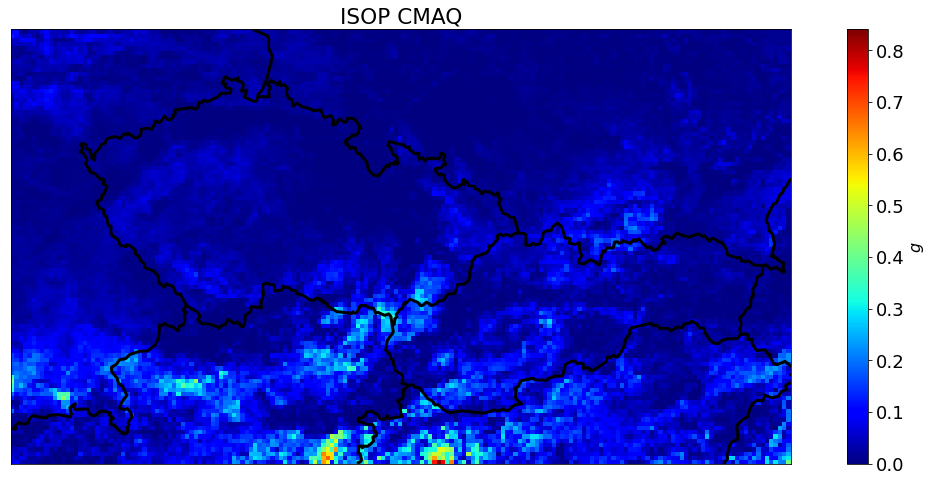

  TERP MEG/CMAQ: 1.512495756149292


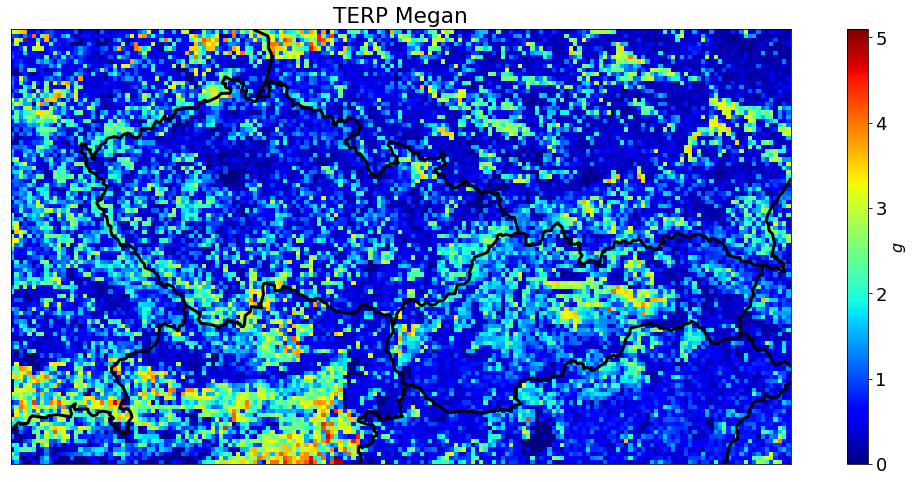

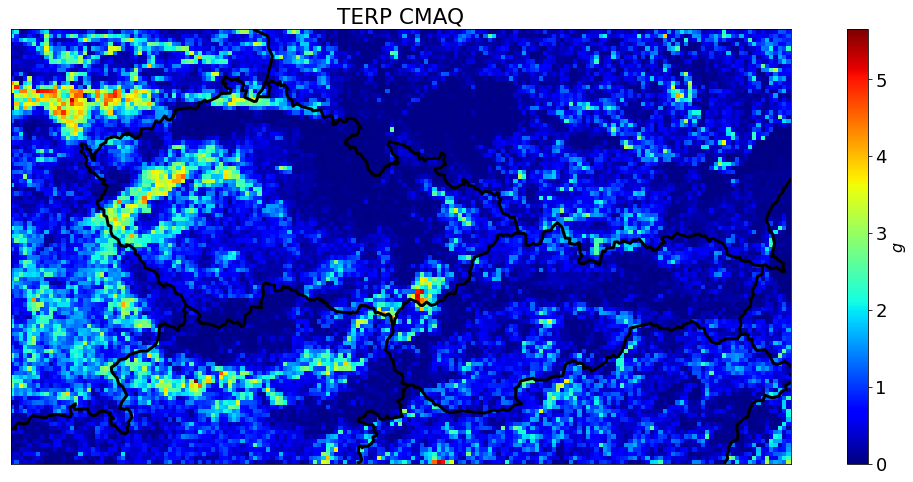

  PAR MEG/CMAQ: 6.969971656799316


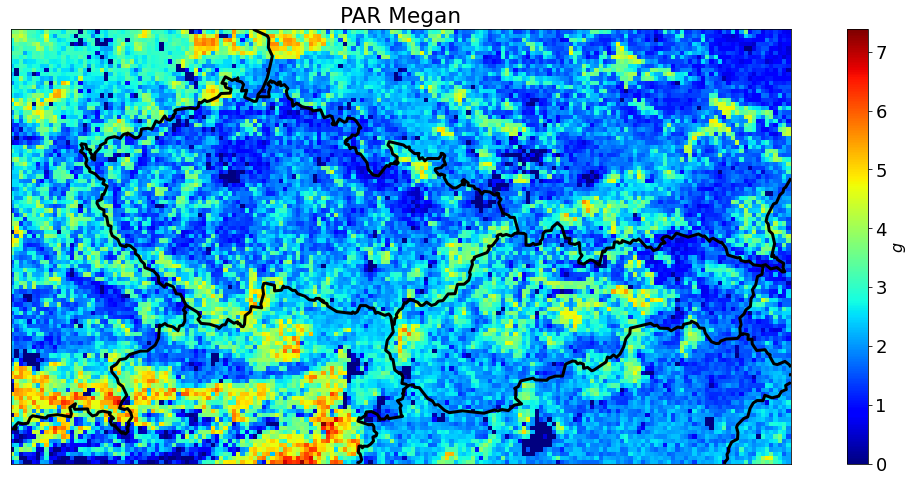

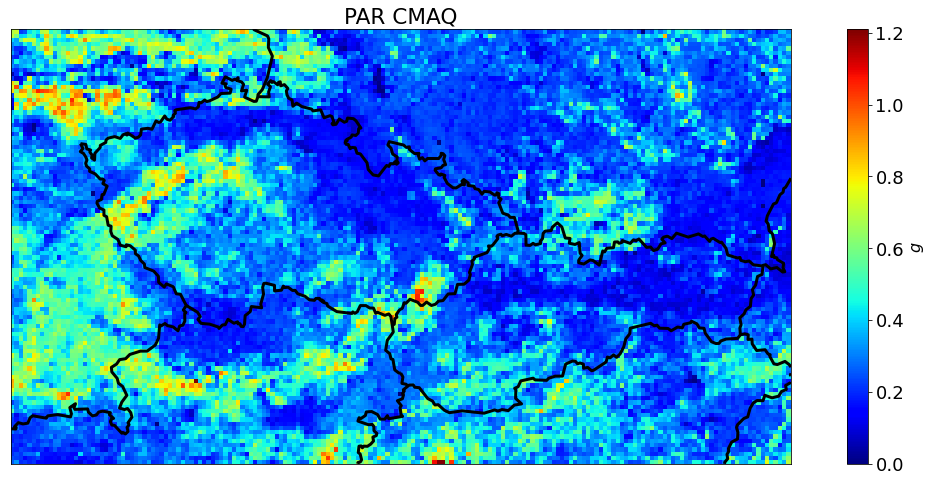

  OLE MEG/CMAQ: 1.986375093460083


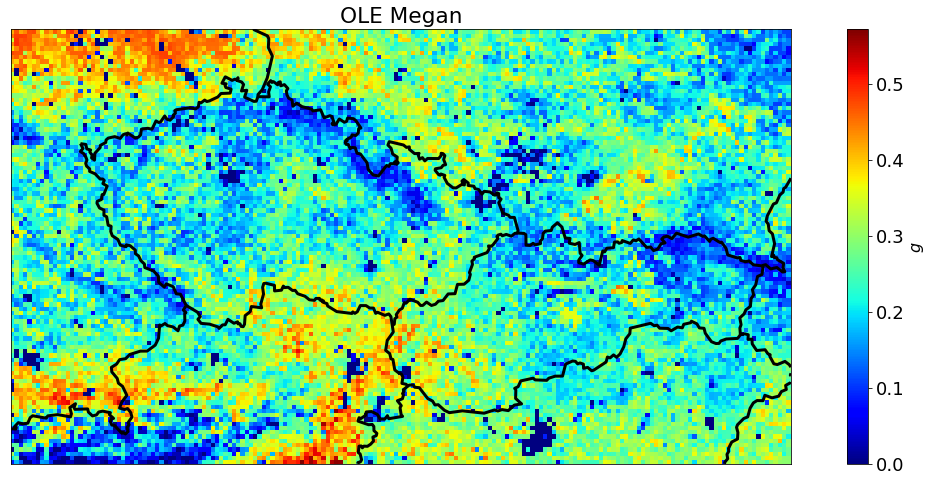

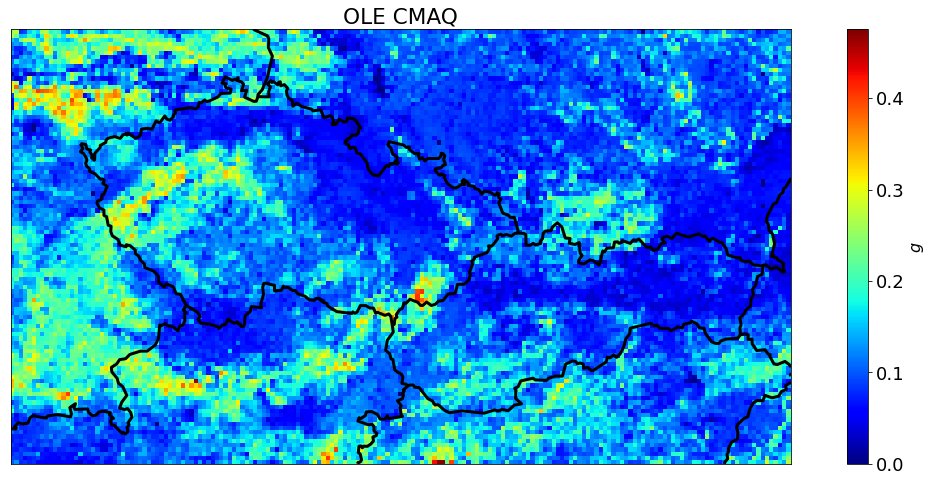

  MEOH MEG/CMAQ: 198.82443237304688


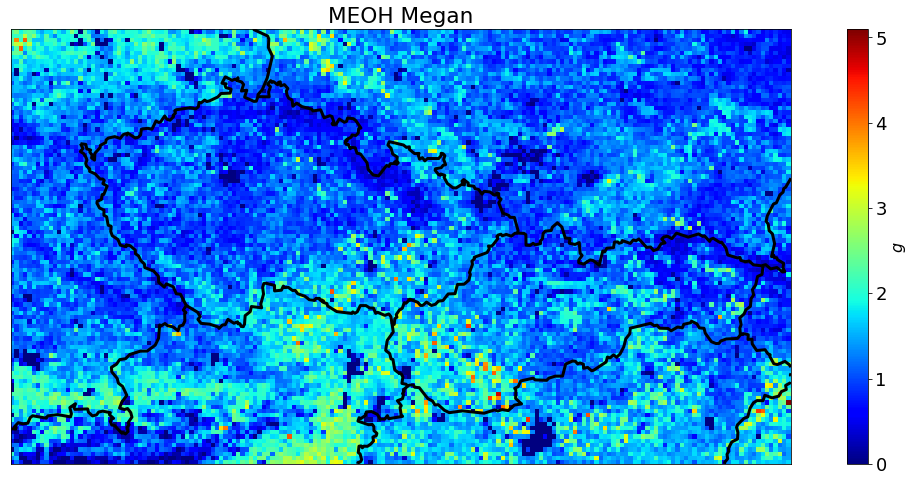

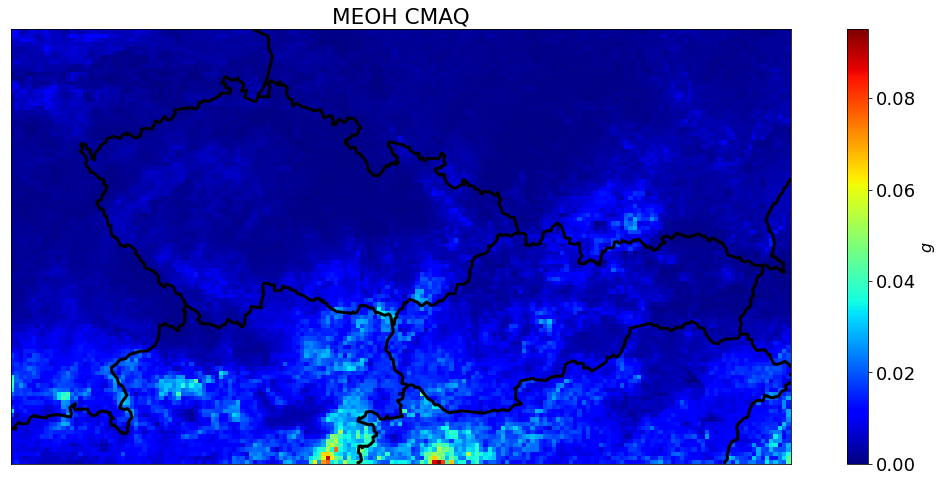

  NO MEG/CMAQ: 0.07141541689634323


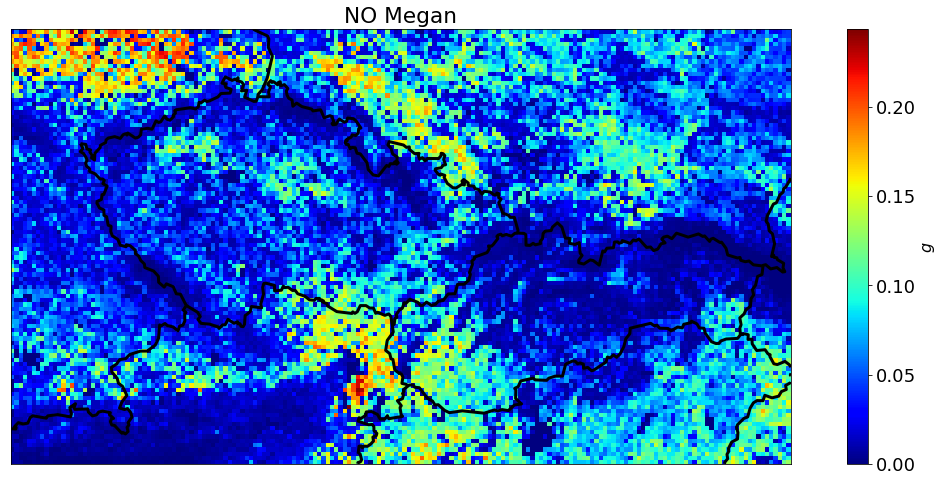

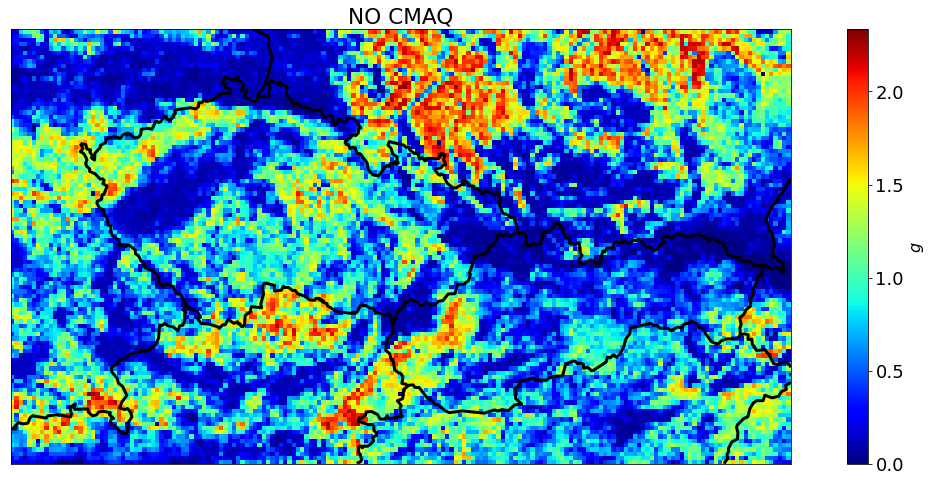

  ALD2 MEG/CMAQ: 0.47264450788497925


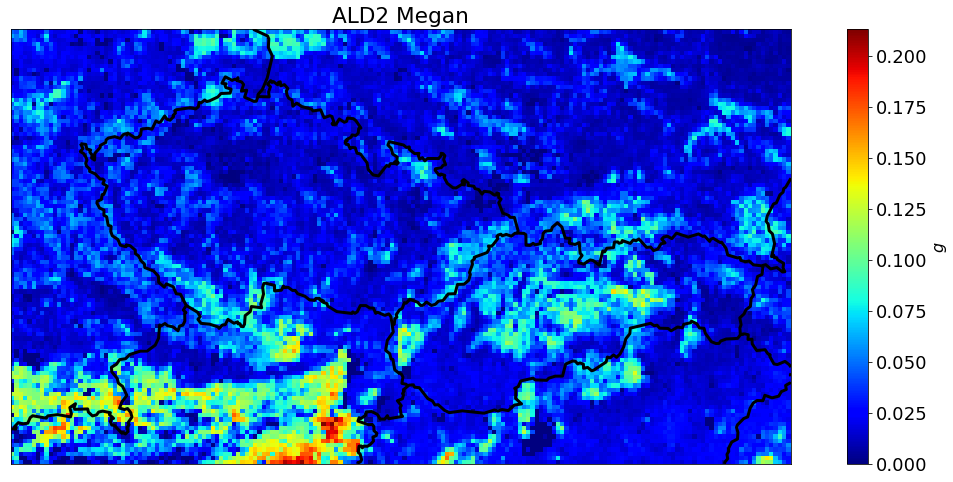

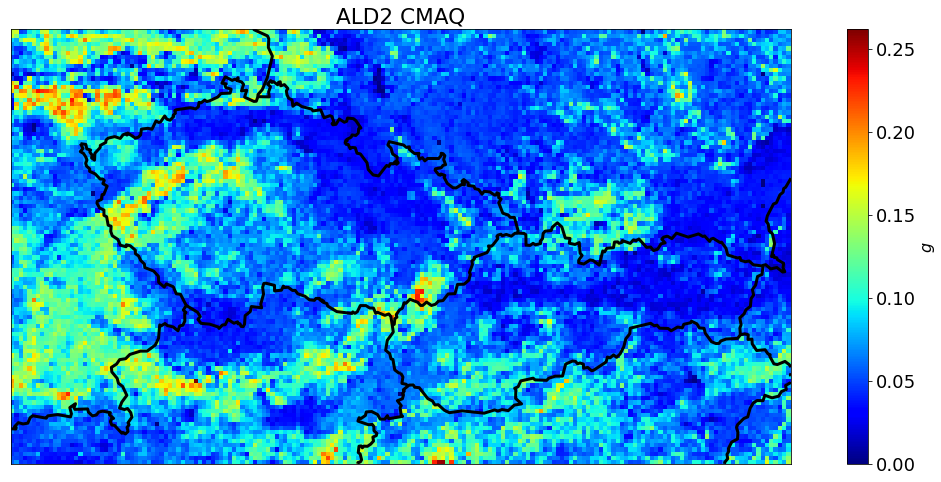

  ETOH MEG/CMAQ: 0.1999262571334839


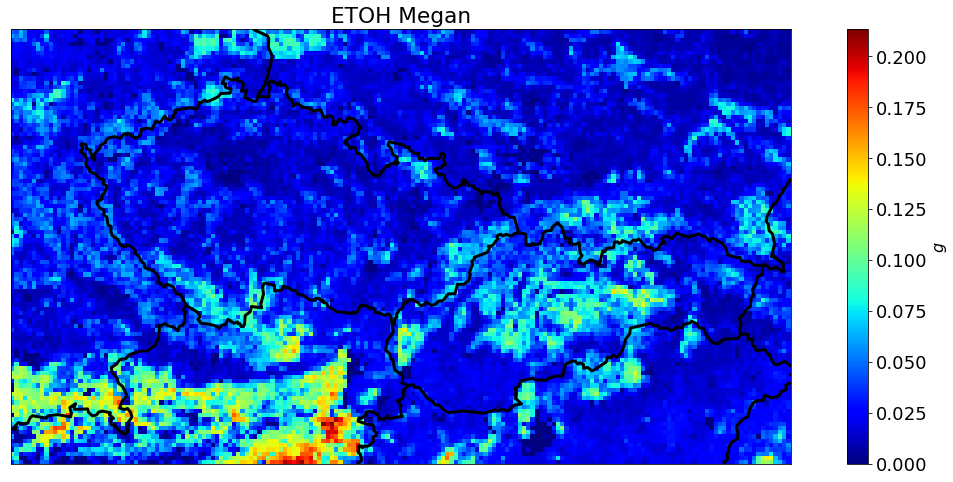

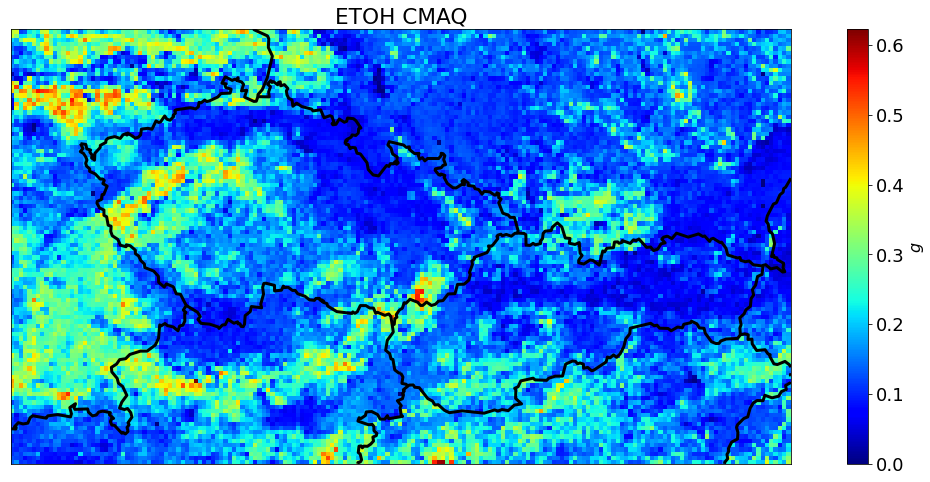

  FORM MEG/CMAQ: 0.113425113260746


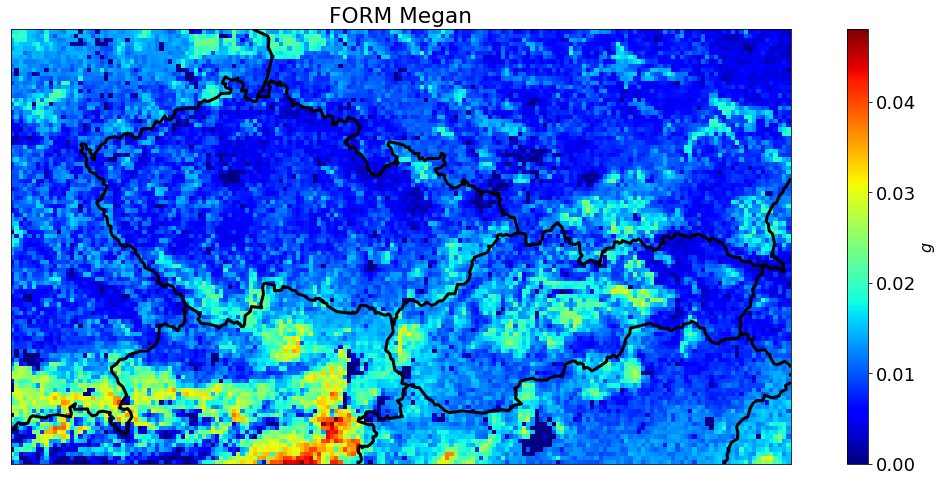

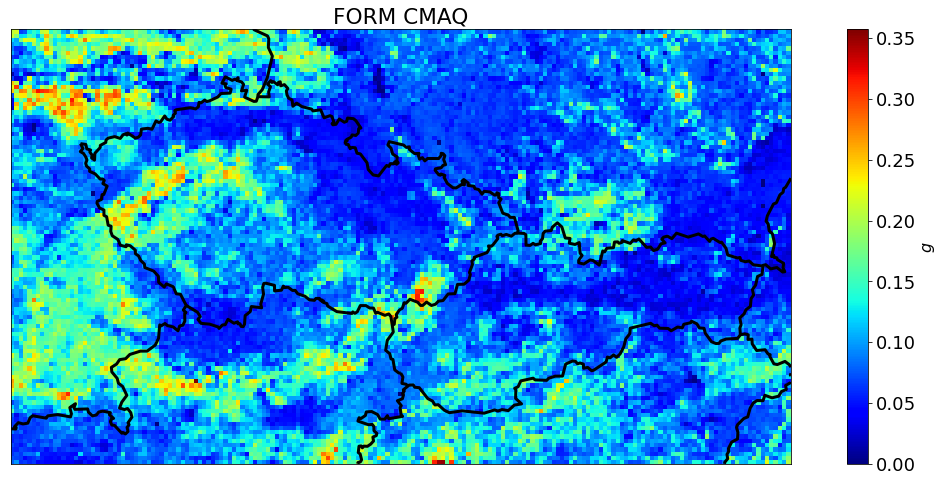

  ALDX MEG/CMAQ: 1.7776907682418823


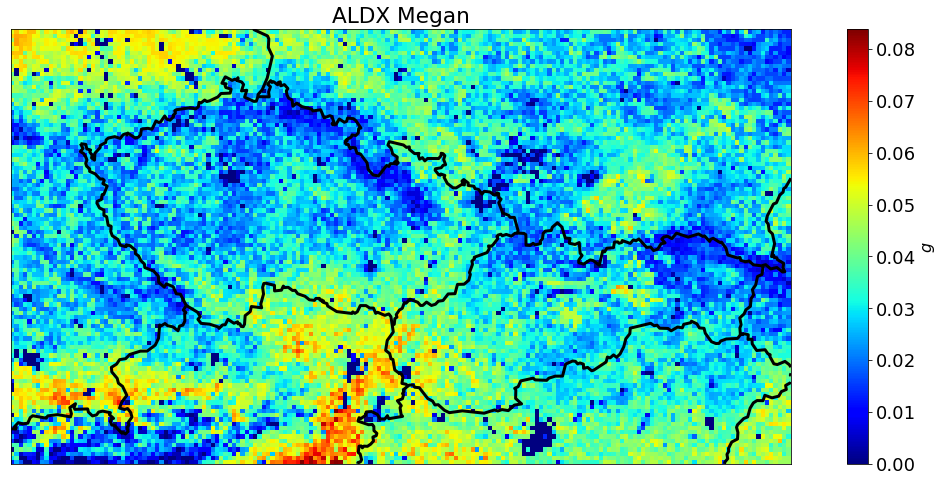

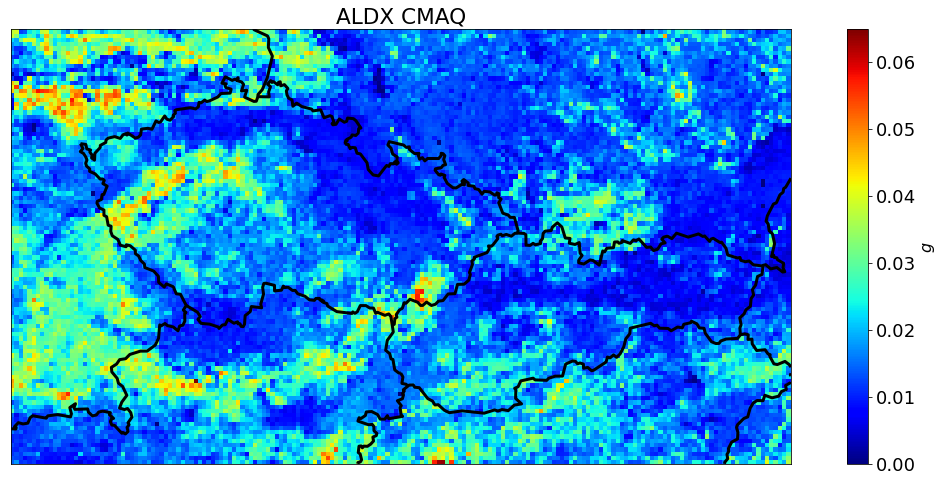

  IOLE MEG/CMAQ: 0.13038596510887146


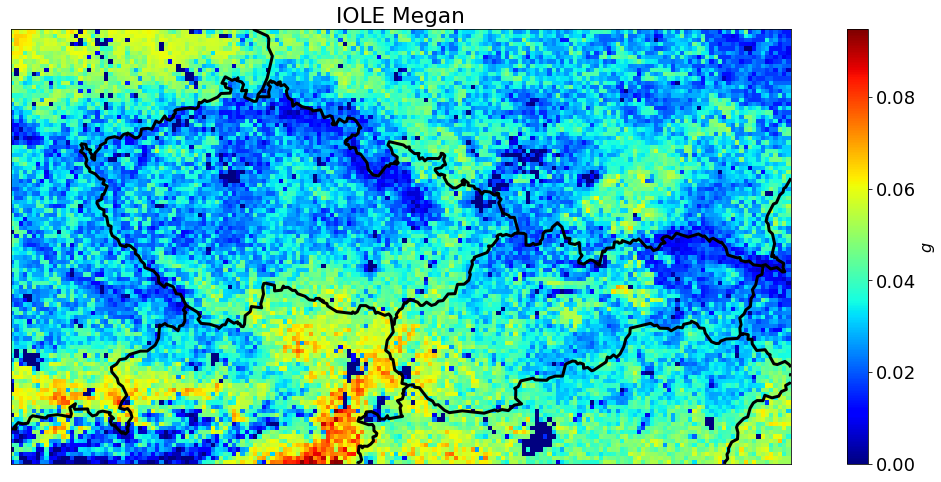

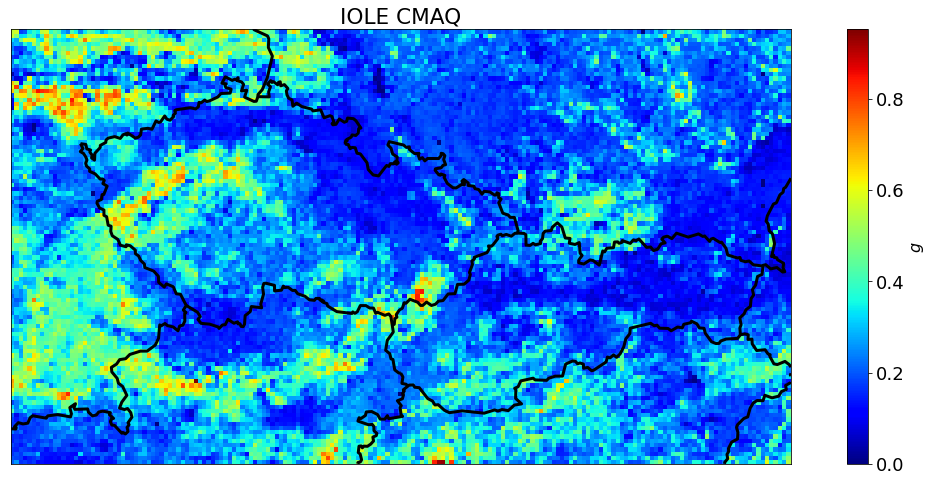

  CO MEG/CMAQ: 0.16376829147338867


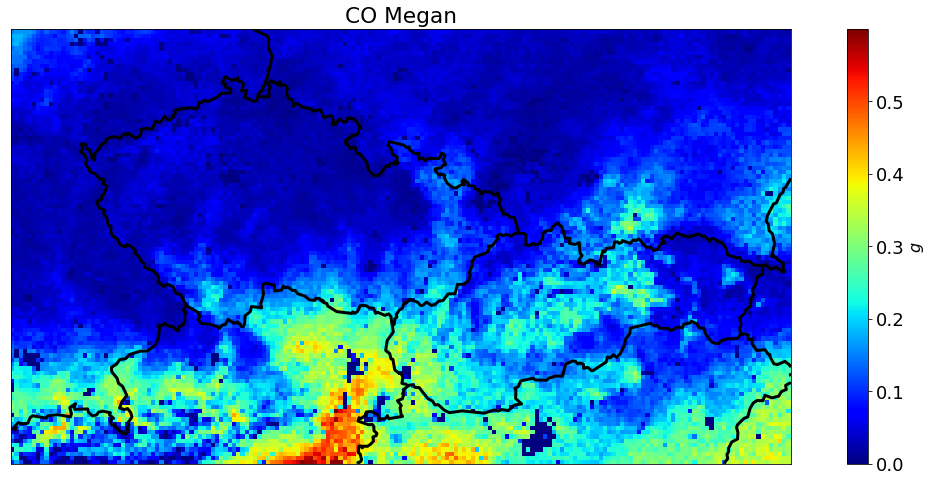

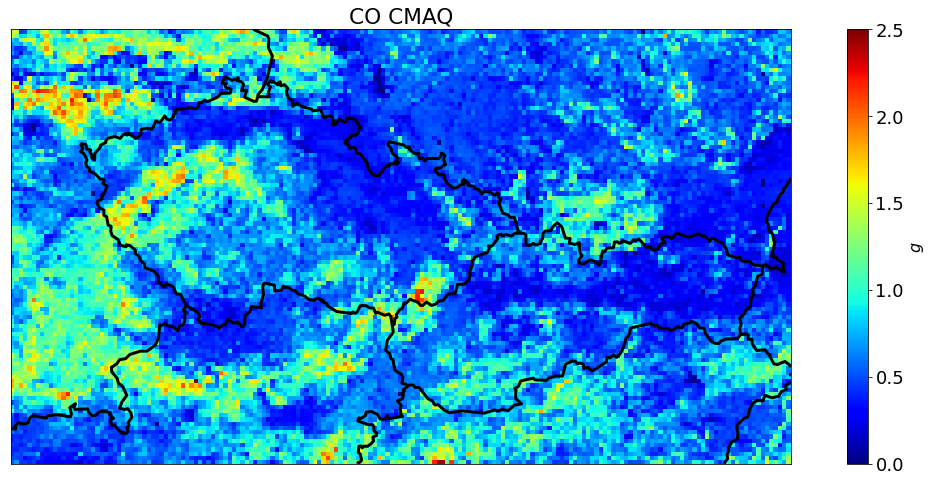

  ETHA MEG/CMAQ: 0.15056242048740387


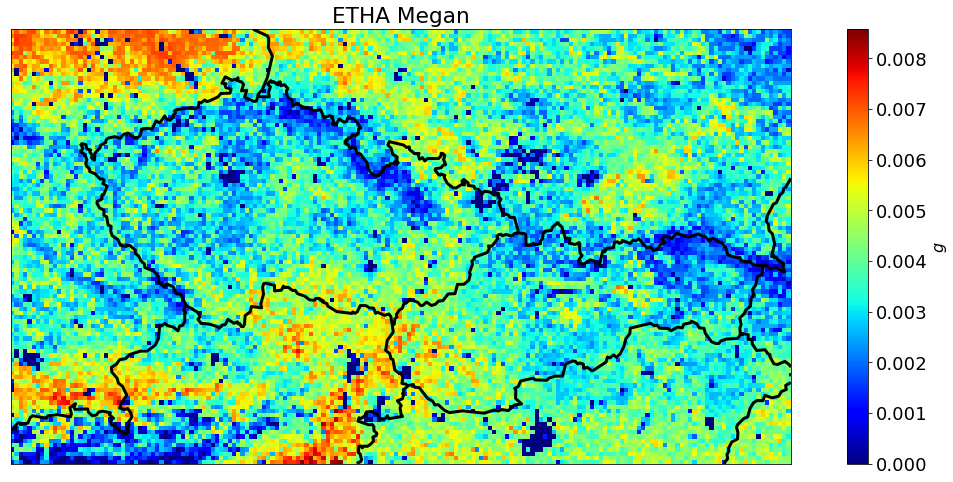

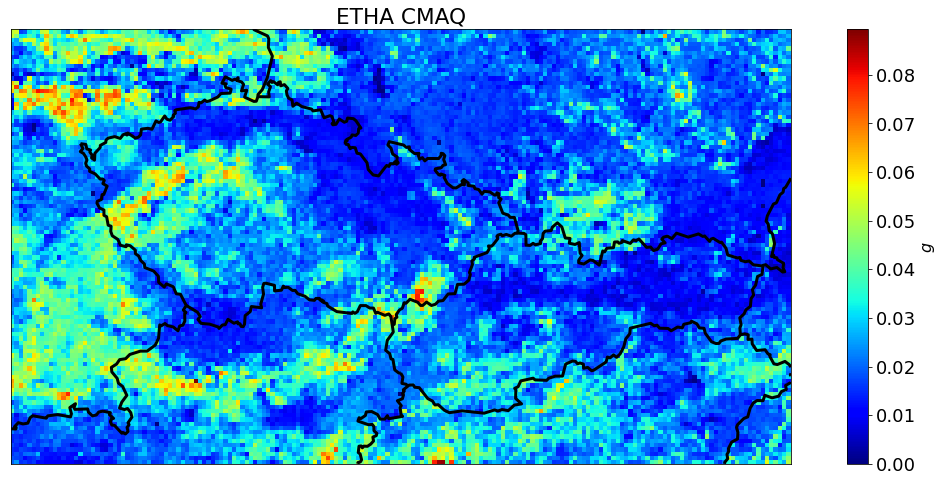

  ETH MEG/CMAQ: 1.2698047161102295


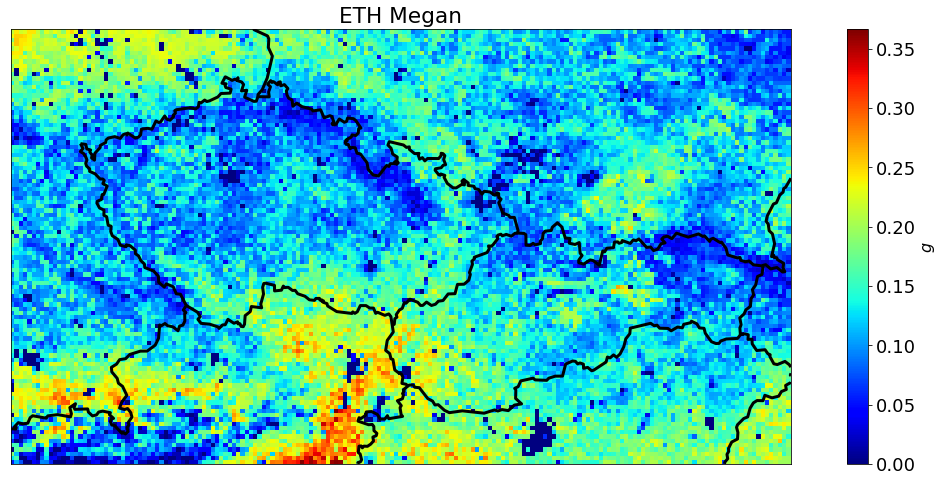

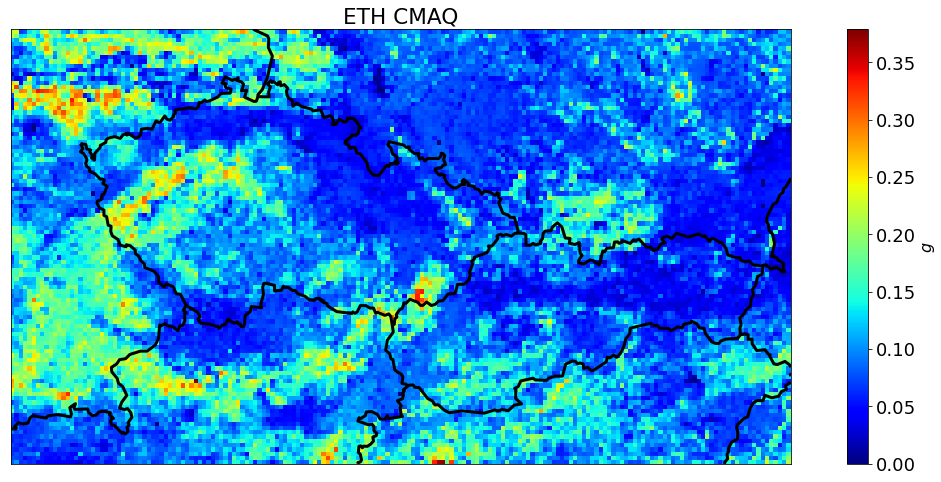

In [37]:
for i in list(meg_2j.variables.keys())[1:]:
    if i in list(cmaq1.variables.keys())[1:]:
        
        dat_meg=np.sum(meg_2j.variables[i][:,0,:,:],axis=0)*dic_konv[i]
        dat_cmaq=np.sum(cmaq1.variables[i][:,0,:,:],axis=0)
        
        print(f"  {i} MEG/CMAQ: {np.sum(dat_meg)/np.sum(dat_cmaq)}")
        
              
        mapb.drawcountries(linewidth=3)
        b=mapb.pcolormesh(lond02,latd02,dat_meg,latlon=True,cmap=plt.cm.jet)# vmin=0,vmax=50)

        cb=plt.colorbar(b,label='g')
        #cb.set_ticks()

        cb.ax.yaxis.label.set_font_properties(font)
        plt.title(f'{i} Megan')

        #plt.savefig('/data/oko/ochrana_ovzdusia_2019/hustota_obrazok', dpi=300, bbox_inches='tight')
        plt.show()
        plt.close()    
        #####
        mapb.drawcountries(linewidth=3)
        b=mapb.pcolormesh(lond02,latd02,dat_cmaq,latlon=True,cmap=plt.cm.jet)# vmin=0,vmax=50)

        cb=plt.colorbar(b,label='g')
        #cb.set_ticks()

        cb.ax.yaxis.label.set_font_properties(font)
        plt.title(f'{i} CMAQ')

        #plt.savefig('/data/oko/ochrana_ovzdusia_2019/hustota_obrazok', dpi=300, bbox_inches='tight')
        plt.show()
        plt.close()    

# Co treba spravit
1. Treba porozmyslat, preco je taky velky rozdiel medzi CAMS a MEGAN datami, ci som sa niekde nepomylil, najma v konverznych faktoroch.
2. Treba sa zamysliet trocha nad kategorizaciou latok v biogennych emisiach, Preco CAMS data a MEGAN (pocitane Jurom) vystupy maju rozne latky, ked je to v podstate z toho isteho modelu?
3. Ake su najdolezitejsie biogenne emisie a zamerat sa na ne. Zatail sa zda, podla oboch modelov aj CAMS aj MEGAN, ze najdolezitejsie su Izopreny, Metanol, CO,monoterpeny a ethen. CAMS este dava vyznamne alfa a beta pineny a aceton, tieto latky MEGAN nemal, zatial co MEGAN mal este vyznamne NR (nevieme presne co to je) a PAR (carbon-carbon single bound, tiez nechapem ze aka je toho definicia) 
4. Ak by sme chceli urobit porovnavacku, tak by sa bolo dobre pozriet na model BEIS v CMAQ, a dat mu asi lepsie inputy ako len MODIS data, pozriet sa, ktore z toho mnozstva landusov su dolezite, a ktore su aj dostupne.
5. Porovnat biogenne emisie voci antropogennym, ci su vobec pre niektore latky vyznamne
6. Citlivost vystupnych koncentracii zakladnych latok z modelu CMAQ na vstupnych biogennych emisiach.